# The Importance of Objective Methods for the Evaluation of Deep Learning Image Processing Devices

## Todo
- Log discriminator real output and generated output values (create histogram containing both)
- Try data parallelization
- Implement realistic noise. 

In [67]:
import os
import time

import graphviz
import numpy as np
import pydot
import tensorflow as tf
from IPython import display
from keras import mixed_precision
from matplotlib import pyplot as plt
from tensorflow import keras

np.set_printoptions(precision=3)
np.set_printoptions(suppress=True)

In [68]:
# Set number of GPUs to be used
gpus = tf.config.list_physical_devices("GPU")
gpus = gpus[0:2]

tf.config.set_visible_devices(gpus, "GPU")

details = tf.config.experimental.get_device_details(gpus[0])
(major_version, minor_version) = details.get("compute_capability")

# Use mixed precision if supported
if major_version >= 7:
    mixed_precision.set_global_policy("mixed_float16")

# Disable default behavior of allocating all GPU memory
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

# strategy = tf.distribute.MirroredStrategy()

In [69]:
# Imported image set as numpy arrays. For more info on converting images to numpy arrays, 
# refer to imageprocessing/image data.ipynb
master_dir = "/gpfs_projects/seif.younis/NIH Chest X-rays/numpy_arrays/"

train_images = np.load(master_dir + "train.npy", mmap_mode="r")
test_images = np.load(master_dir + "test.npy", mmap_mode="r")

In [70]:
# train_images = train_images.reshape(train_images.shape[0], 128, 128, 1).astype('float32')
# train_images = np.pad(train_images, ((0,0),(2,2),(2,2),(0,0)), 'constant')

# test_images = test_images.reshape(test_images.shape[0], 128, 128, 1).astype('float32')
# test_images = np.pad(test_images, ((0,0),(2,2),(2,2),(0,0)), 'constant')

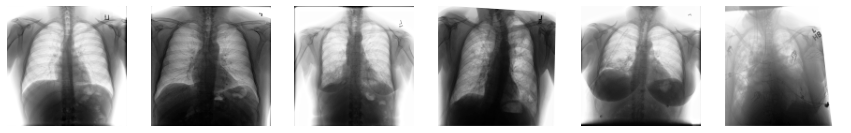

In [71]:
plt.figure(figsize=(15, 15))

for i in range(6):
    plt.subplot(1, 6, i + 1)
    plt.imshow(train_images[i].reshape(128, 128), cmap="Greys")
    plt.axis("off")
plt.show()

In [72]:
VAR = 70 # Adjust as necessary to control noise level

### Add noise to images

In [73]:
train_noisy_images = train_images.copy()
test_noisy_images = test_images.copy()

print(train_images.shape[0])
print(test_images.shape[0])

inp = train_images[0]
re = test_images[0]

for i in range(0, train_images.shape[0]):
    mean = 0
    var = VAR
    
    # if i <= train_images.shape[0] / 3:
    #     var = 20
    # elif i <= 2 * train_images.shape[0] / 3:
    #     var = 50
    # else:
    #     var = 70
    
    gauss = np.random.normal(mean, var, train_noisy_images[i].shape)
    train_noisy_images[i] += gauss
    train_noisy_images[i] = np.clip(train_noisy_images[i], 0, 255)

for i in range(0, test_noisy_images.shape[0]):
    mean = 0
    var = VAR
    gauss = np.random.normal(mean, var, test_noisy_images[i].shape)
    test_noisy_images[i] += gauss
    test_noisy_images[i] = np.clip(test_noisy_images[i], 0, 255)

84999
2000


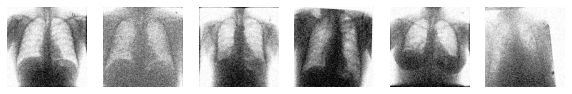

In [74]:
plt.figure(figsize=(10, 10))

for i in range(6):
    plt.subplot(1, 6, i + 1)
    plt.imshow(train_noisy_images[i].reshape(128, 128), cmap="Greys")
    plt.axis("off")
plt.show()

In [75]:
BUFFER_SIZE = train_images.shape[0]

# Adjust as necessary
BATCH_SIZE = 64
IMG_WIDTH = 128
IMG_HEIGHT = 128

OUTPUT_CHANNELS = 1

In [76]:
train_noisy_images = (
    train_noisy_images - 127.5
) / 127.5  # Normalize the images to [-1, 1]
train_images = (train_images - 127.5) / 127.5  # Normalize the images to [-1, 1]

In [77]:
test_images = (test_images - 127.5) / 127.5  # Normalize the images to [-1, 1]
test_noisy_images = (
    test_noisy_images - 127.5
) / 127.5  # Normalize the images to [-1, 1]

In [78]:
test_images = tf.data.Dataset.from_tensor_slices(
    (test_images, test_noisy_images)
).batch(BATCH_SIZE)
# test_images = strategy.experimental_distribute_dataset(test_images)

In [79]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0.0, 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(
            filters,
            size,
            strides=2,
            padding="same",
            kernel_initializer=initializer,
            use_bias=False,
        )
    )

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

In [80]:
down_model = downsample(1, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print(down_result.shape)

(1, 64, 64, 1)


In [81]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0.0, 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(
            filters,
            size,
            strides=2,
            padding="same",
            kernel_initializer=initializer,
            use_bias=False,
        )
    )

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

In [82]:
up_model = upsample(1, 4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 128, 128, 1)


In [83]:
def Generator():
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])

    down_stack = [
        downsample(16, 5, apply_batchnorm=False),  # (bs, 16, 16, 16)
        downsample(32, 5),  # (bs, 8, 8, 32)
        downsample(64, 5),  # (bs, 4, 4, 64)
        downsample(64, 5),  # (bs, 2, 2, 64)
        downsample(64, 5),  # (bs, 1, 1, 64)
    ]

    up_stack = [
        upsample(64, 5, apply_dropout=True),  # (bs, 2, 2, 128)
        upsample(64, 5, apply_dropout=True),  # (bs, 4, 4, 128)
        upsample(32, 5),  # (bs, 8, 8, 64)
        upsample(16, 5),  # (bs, 16, 16, 32)
    ]

    initializer = tf.random_normal_initializer(0.0, 0.02)
    last = tf.keras.layers.Conv2DTranspose(
        OUTPUT_CHANNELS,
        4,
        strides=2,
        padding="same",
        kernel_initializer=initializer,
        activation="tanh",
        dtype="float32",
    )  # (bs, 32, 32, 1)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [84]:
# def Generator():
#     inputs = tf.keras.layers.Input(shape=[128,128,1])

#     block = keras.Sequential(name='conv0')
#     block.add(keras.layers.Conv2D(8, 5, strides=1, padding='same', use_bias=False)) # (bs, 128, 128, 32)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.LeakyReLU())
#     x = block(inputs)

#     block = keras.Sequential(name='conv1')
#     block.add(keras.layers.Conv2D(32, 5, strides=1, padding='same', use_bias=False)) # ()
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.LeakyReLU())
#     block.add(keras.layers.MaxPool2D(pool_size=32, strides=1, padding='same'))
#     x1_conv = block(x)

#     block = keras.Sequential(name='conv2')
#     block.add(keras.layers.Conv2D(64, 5, strides=2,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.LeakyReLU())
#     block.add(keras.layers.MaxPool2D(pool_size=64, strides=1, padding='same'))
#     x2_conv = block(x1_conv)

#     block = keras.Sequential(name='conv3')
#     block.add(keras.layers.Conv2D(128, 5, strides=2,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.LeakyReLU())
#     block.add(keras.layers.MaxPool2D(pool_size=128, strides=1, padding='same'))
#     x3_conv = block(x2_conv)

#     block = keras.Sequential(name='conv4')
#     block.add(keras.layers.Conv2D(256, 5, strides=2,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.LeakyReLU())
#     block.add(keras.layers.MaxPool2D(pool_size=256, strides=1, padding='same'))
#     x4_conv = block(x3_conv)

#     block = keras.Sequential(name='conv5')
#     block.add(keras.layers.Conv2D(512, 5, strides=2,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.LeakyReLU())
#     block.add(keras.layers.MaxPool2D(pool_size=512, strides=1, padding='same'))
#     x5_conv = block(x4_conv)

#     block = keras.Sequential(name='deconv4')
#     block.add(keras.layers.Conv2DTranspose(256, 5, strides=2,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.Dropout(0.5))
#     block.add(keras.layers.ReLU())
#     x4_deconv = block(x5_conv)

#     x = keras.layers.Concatenate()([x4_conv, x4_deconv])

#     block = keras.Sequential(name='deconv3')
#     block.add(keras.layers.UpSampling2D(size=2))
#     block.add(keras.layers.Conv2DTranspose(128, 5, strides=1,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.Dropout(0.5))
#     block.add(keras.layers.ReLU())
#     x3_deconv = block(x)

#     x = keras.layers.Concatenate()([x3_conv, x3_deconv])

#     block = keras.Sequential(name='deconv2')
#     block.add(keras.layers.UpSampling2D(size=2))
#     block.add(keras.layers.Conv2DTranspose(64, 5, strides=1,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.Dropout(0.5))
#     block.add(keras.layers.ReLU())
#     x2_deconv = block(x)

#     x = keras.layers.Concatenate()([x2_conv, x2_deconv])

#     block = keras.Sequential(name='deconv1')
#     block.add(keras.layers.UpSampling2D(size=2))
#     block.add(keras.layers.Conv2DTranspose(32, 5, strides=1,padding='same',use_bias=False)) # (bs, 8, 8, 64)
#     block.add(keras.layers.BatchNormalization())
#     block.add(keras.layers.Dropout(0.5))
#     block.add(keras.layers.ReLU())
#     x1_deconv = block(x)

#     x = keras.layers.Concatenate()([x1_conv, x1_deconv])

#     x = keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 5,
#                                     strides=1,
#                                     padding='same',
#                                     activation='tanh')(x) # (bs, 32, 32, 1)

#     return tf.keras.Model(inputs=inputs, outputs=x)

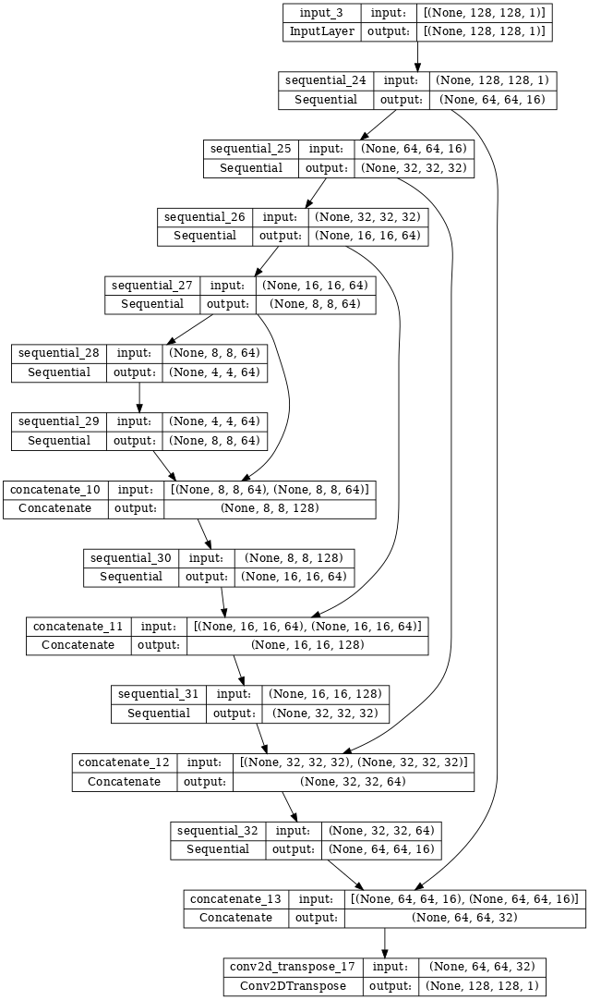

In [85]:
# with strategy.scope():
generator = Generator()

tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

## Define the Generator loss

  * It is a sigmoid cross entropy loss of the generated images and an **array of ones**.
  * The [paper](https://arxiv.org/abs/1611.07004) also includes L1 loss which is MAE (mean absolute error) between the generated image and the target image.
  * This allows the generated image to become structurally similar to the target image.
  * The formula to calculate the total generator loss = gan_loss + LAMBDA * l1_loss, where LAMBDA = 100. This value was decided by the authors of the [paper](https://arxiv.org/abs/1611.07004).

In [86]:
# LAMBDA = 100

In [87]:
def generator_loss(disc_generated_output, gen_output, target, LAMBDA):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # SSIM loss
    ssim_loss = 1 - tf.reduce_mean(tf.image.ssim(gen_output, target, max_val=2))

    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss, ssim_loss

# Build the Discriminator

* The Discriminator is a PatchGAN.
* Each block in the discriminator is (Conv -> BatchNorm -> Leaky ReLU)
* The shape of the output after the last layer is (batch_size, 6, 6, 1)
* Each 6x6 patch of the output classifies a 14x14 portion of the input image (such an architecture is called a PatchGAN).
* Discriminator receives 2 inputs.
  * Input image and the target image, which it should classify as real.
  * Input image and the generated image (output of generator), which it should classify as fake.
  * We concatenate these 2 inputs together in the code (`tf.concat([inp, tar], axis=-1)`)

In [88]:
# def Discriminator():
#     initializer = tf.random_normal_initializer(0., 0.02)

#     inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
#     tar = tf.keras.layers.Input(shape=[128, 128, 1], name='target_image')

#     x = tf.keras.layers.concatenate([inp, tar]) # (bs, 32, 32, channels*2)

#     down1 = downsample(16, 5, False)(x) # (bs, 16, 16, 16)
#     down2 = downsample(32, 5)(down1) # (bs, 8, 8, 32)

#     zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2) # (bs, 10, 10, 32)
#     conv = tf.keras.layers.Conv2D(32, 5, strides=1,
#                                 kernel_initializer=initializer,
#                                 use_bias=False)(zero_pad1) # (bs, 7, 7, 32)

#     batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

#     leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

#     zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 9, 9, 32)

#     last = tf.keras.layers.Conv2D(1, 5, strides=1,
#                                 kernel_initializer=initializer, dtype='float32')(zero_pad2) # (bs, 6, 6, 1)

#     return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [89]:
def Discriminator():
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name="input_image")
    tar = tf.keras.layers.Input(shape=[128, 128, 1], name="target_image")

    kernel_size = 5

    x = tf.keras.layers.concatenate([inp, tar])  # (bs, 32, 32, channels*2)

    x = keras.layers.Conv2D(1, kernel_size, strides=1, padding="same")(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(64, kernel_size, strides=2, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(128, kernel_size, strides=1, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(128, kernel_size, strides=2, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(256, kernel_size, strides=1, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(256, kernel_size, strides=2, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(512, kernel_size, strides=1, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Conv2D(512, kernel_size, strides=2, padding="same")(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)

    x = keras.layers.Dense(1024)(x)
    x = keras.layers.LeakyReLU(alpha=0.2)(x)
    x = keras.layers.Dense(1, activation="sigmoid", dtype="float32")(x)

    return tf.keras.Model(inputs=[inp, tar], outputs=x)

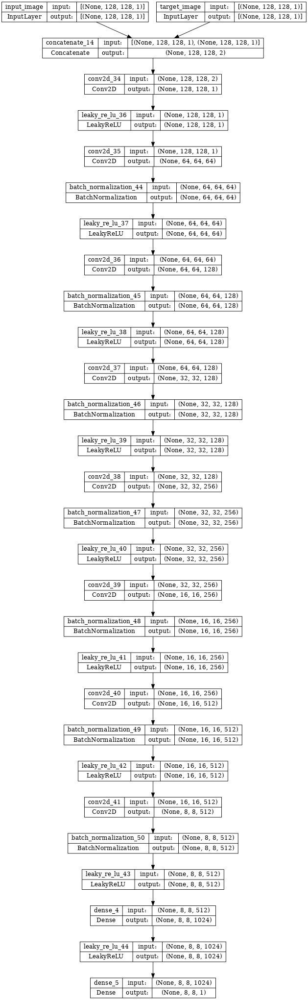

In [90]:
# with strategy.scope():
discriminator = Discriminator()

tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

## The Discriminator loss

  * The discriminator loss function takes 2 inputs; **real images, generated images**
  * real_loss is a sigmoid cross entropy loss of the **real images** and an **array of ones(since these are the real images)**
  * generated_loss is a sigmoid cross entropy loss of the **generated images** and an **array of zeros(since these are the fake images)**
  * Then the total_loss is the sum of real_loss and the generated_loss

In [91]:
# with strategy.scope():
loss_object = tf.keras.losses.BinaryCrossentropy()

In [92]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(
        tf.zeros_like(disc_generated_output), disc_generated_output
    )

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

## Define the Optimizers and Checkpoint-saver

In [93]:
import datetime

checkpoint_dir = "./training_checkpoints/" + datetime.datetime.now().strftime(
    "%m%d-%H%M"
)
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")

# with strategy.scope():
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.9)

# if major_version >= 7:
#     generator_optimizer = mixed_precision.LossScaleOptimizer(generator_optimizer)
#     discriminator_optimizer = mixed_precision.LossScaleOptimizer(discriminator_optimizer)

checkpoint = tf.train.Checkpoint(
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer,
    generator=generator,
    discriminator=discriminator,
)

## Generate Images

In [94]:
def generate_images(model, test_input, tar):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15, 15))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ["Input Image", "Ground Truth", "Predicted Image"]

    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(tf.reshape(display_list[i], (128, 128)) * 0.5 + 0.5, cmap="Greys")
        plt.axis("off")
    plt.show()

# Training

* For each example input generate an output.
* The discriminator receives the input_image and the generated image as the first input. The second input is the input_image and the target_image.
* Next, we calculate the generator and the discriminator loss.
* Then, we calculate the gradients of loss with respect to both the generator and the discriminator variables(inputs) and apply those to the optimizer.
* Then log the losses to TensorBoard.

In [95]:
EPOCHS_PER_SPLIT = 5

In [96]:
log_dir = "logs/"

summary_writer = tf.summary.create_file_writer(
    log_dir
    + "fit/"
    + datetime.datetime.now().strftime("%m%d-%H%M")
    + "_lambda_"
    + str(LAMBDA)
    + "_var_"
    + str(VAR)
    + "_batch_"
    + str(BATCH_SIZE)
    + "_buffer_"
    + str(BUFFER_SIZE)
)

In [97]:
@tf.function()
def train_step(input_image, target, epoch, LAMBDA):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss, gen_ssim_loss = generator_loss(
            disc_generated_output, gen_output, target, LAMBDA
        )

        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(
        gen_total_loss, generator.trainable_variables
    )
    discriminator_gradients = disc_tape.gradient(
        disc_loss, discriminator.trainable_variables
    )

    generator_optimizer.apply_gradients(
        zip(generator_gradients, generator.trainable_variables)
    )
    discriminator_optimizer.apply_gradients(
        zip(discriminator_gradients, discriminator.trainable_variables)
    )

    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
        tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
        tf.summary.scalar('gen_ssim_loss', gen_ssim_loss, step=epoch)
        tf.summary.scalar('disc_loss', disc_loss, step=epoch)

## The actual training loop

* Iterates over the number of epochs.
* On each epoch it clears the display, and runs `generate_images` to show it's progress.
* On each epoch it iterates over the training dataset, printing a '.' for each example.
* It saves a checkpoint every 20 epochs.

In [98]:
def fit(train_ds, epochs, test_ds, LAMBDA):
    for epoch in range(epochs - EPOCHS_PER_SPLIT, epochs):
        start = time.time()

        # display.clear_output(wait=True)

        for example_target, example_input in test_ds.take(2):
            generate_images(generator, example_input, example_target)
        print("Epoch: ", epoch)

        # Train
        for n, (target, input_image) in train_ds.enumerate():
            if (n + 1) % 10 == 0:
                print(".", end="")
            if (n + 1) % 1000 == 0:
                print()
            train_step(input_image, target, epoch, LAMBDA)
        print()

        # saving (checkpoint) the model every 20 epochs
        if (epoch + 1) % 10 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        print(
            "Time taken for epoch {} is {} sec\n".format(epoch + 1, time.time() - start)
        )
    checkpoint.save(file_prefix=checkpoint_prefix)

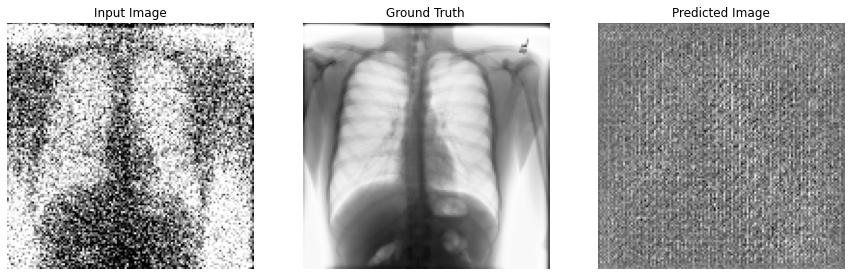

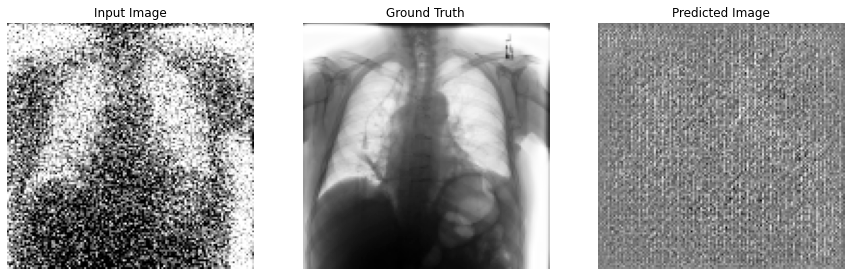

Epoch:  0
........
Time taken for epoch 1 is 15.124949932098389 sec



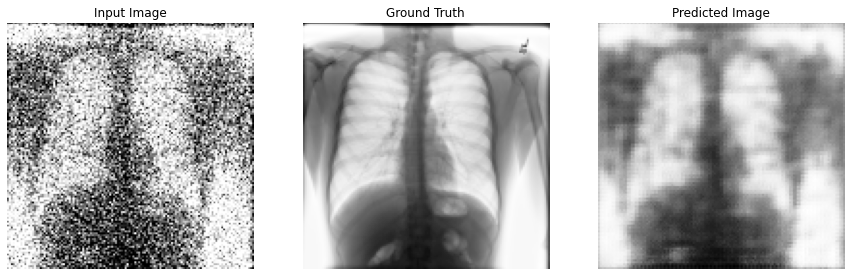

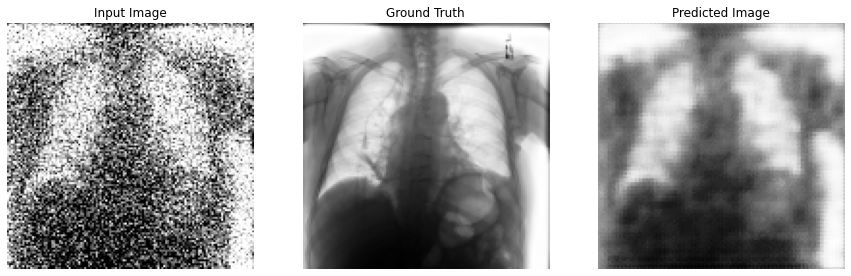

Epoch:  1
........
Time taken for epoch 2 is 13.774651765823364 sec



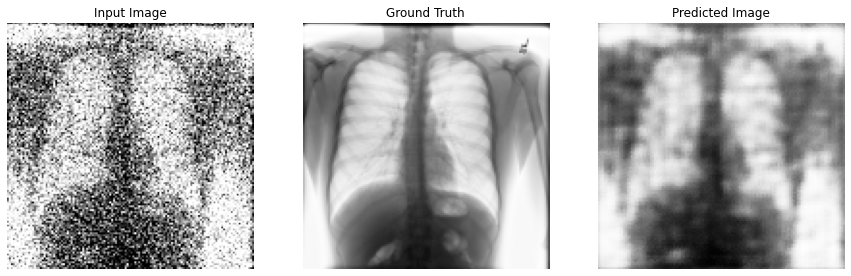

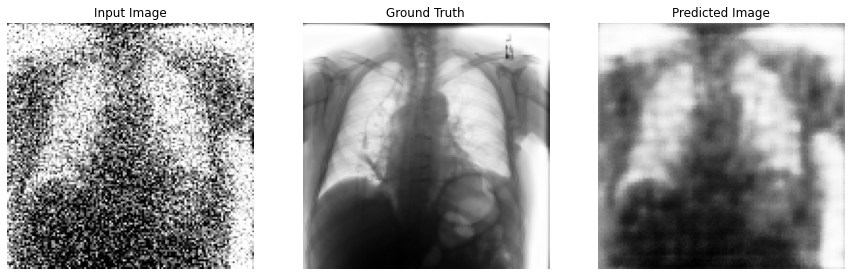

Epoch:  2
........
Time taken for epoch 3 is 13.910844326019287 sec



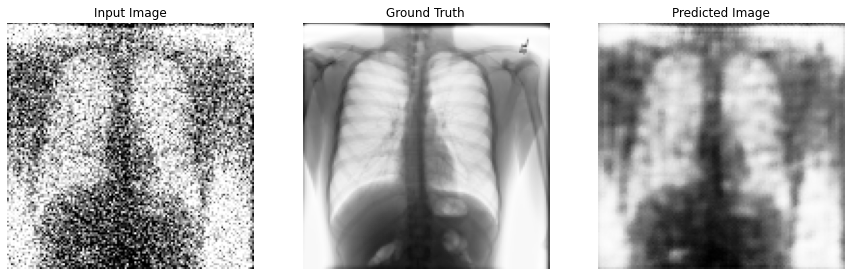

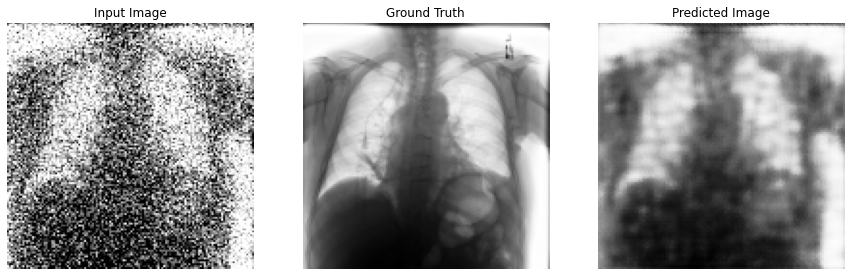

Epoch:  3
........
Time taken for epoch 4 is 15.30433964729309 sec



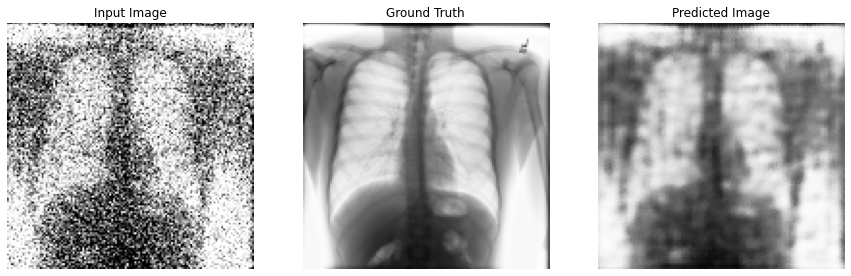

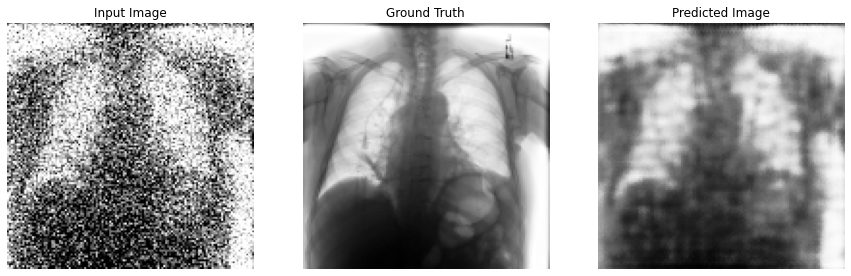

Epoch:  4
........
Time taken for epoch 5 is 13.92436933517456 sec



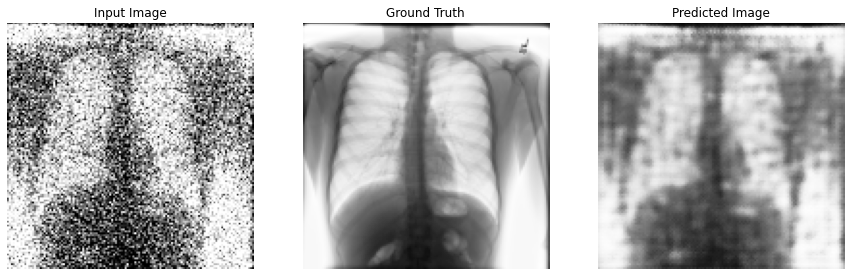

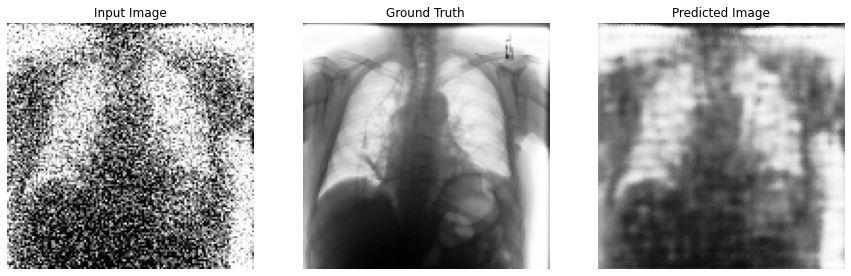

Epoch:  5
........
Time taken for epoch 6 is 14.007506608963013 sec



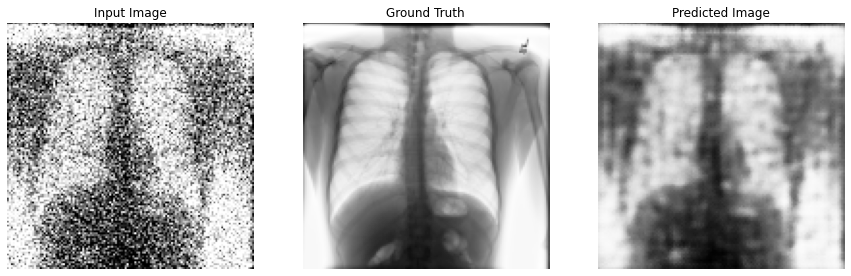

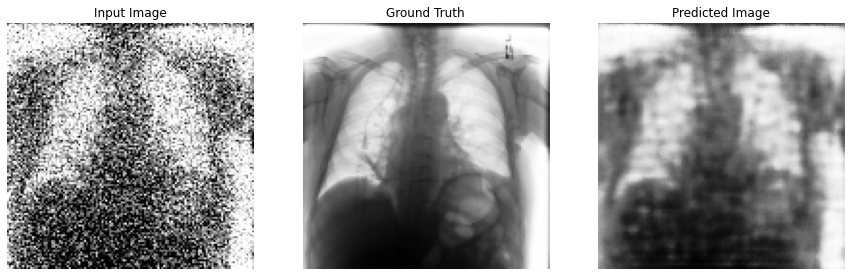

Epoch:  6
........
Time taken for epoch 7 is 13.707957029342651 sec



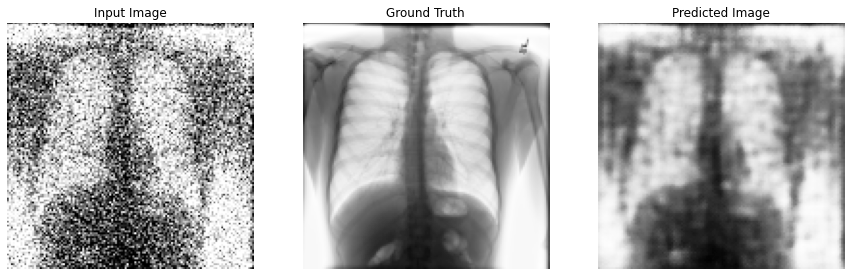

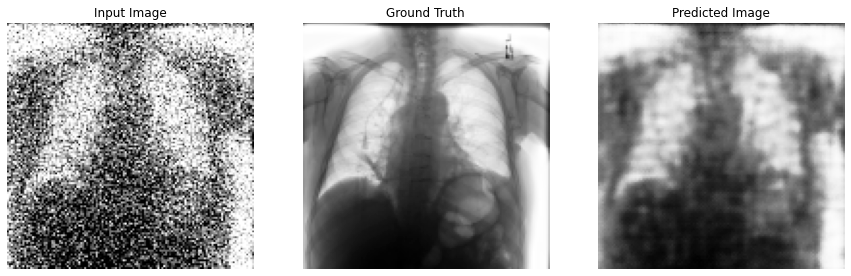

Epoch:  7
........
Time taken for epoch 8 is 13.895783424377441 sec



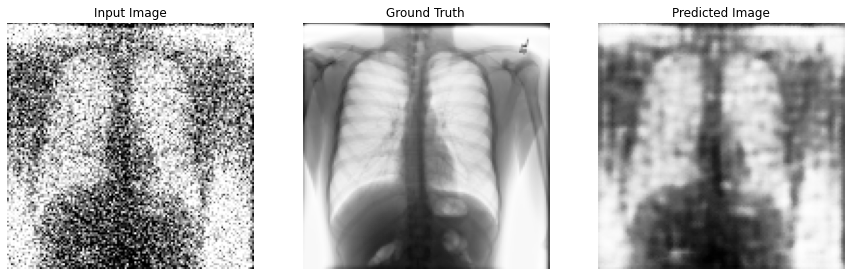

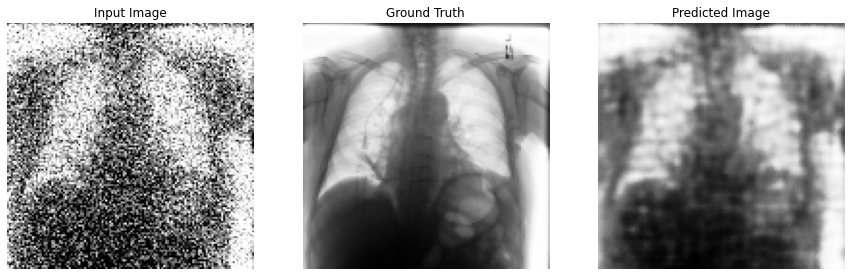

Epoch:  8
........
Time taken for epoch 9 is 13.836602210998535 sec



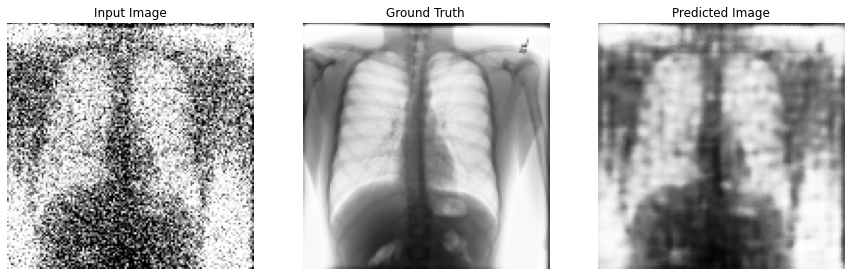

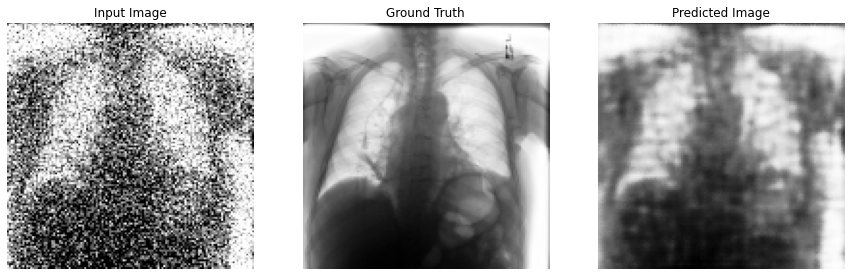

Epoch:  9
........
Time taken for epoch 10 is 15.688066482543945 sec



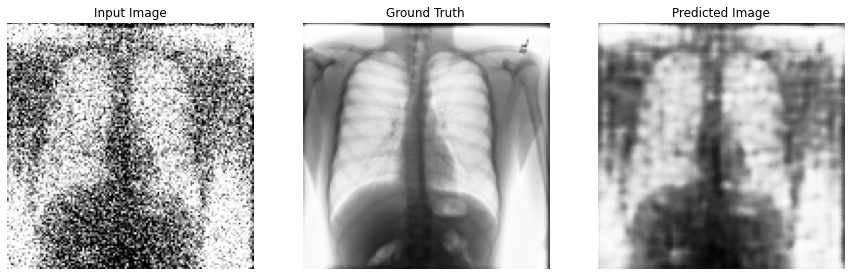

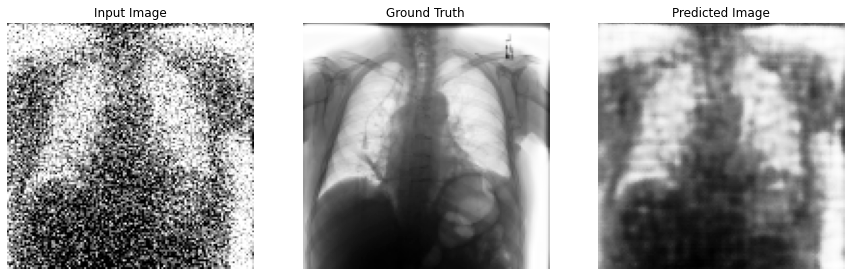

Epoch:  10
........
Time taken for epoch 11 is 13.766502618789673 sec



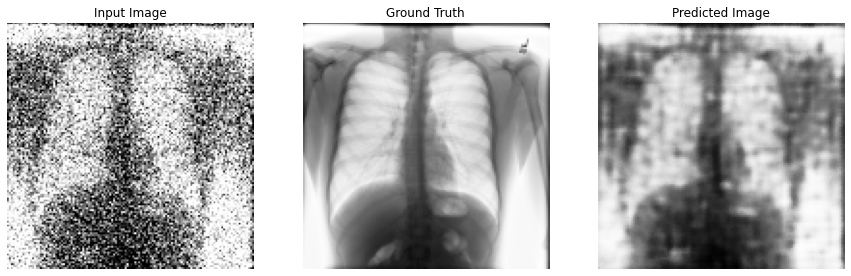

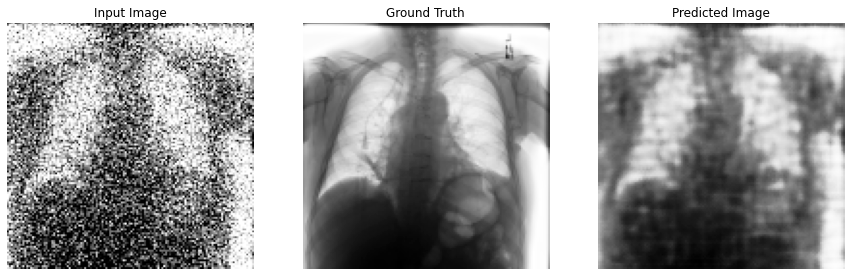

Epoch:  11
........
Time taken for epoch 12 is 14.032898426055908 sec



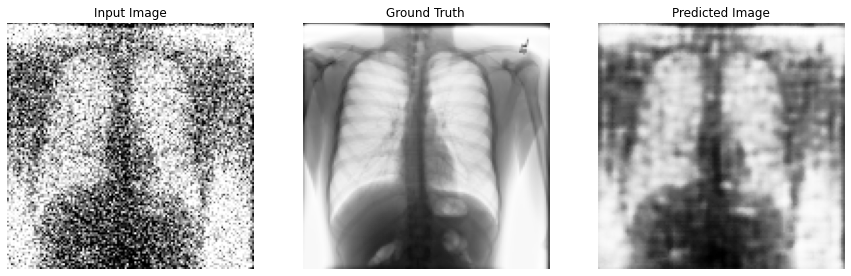

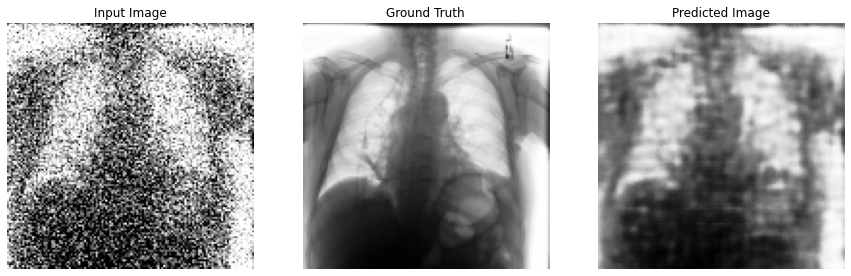

Epoch:  12
........
Time taken for epoch 13 is 13.815474271774292 sec



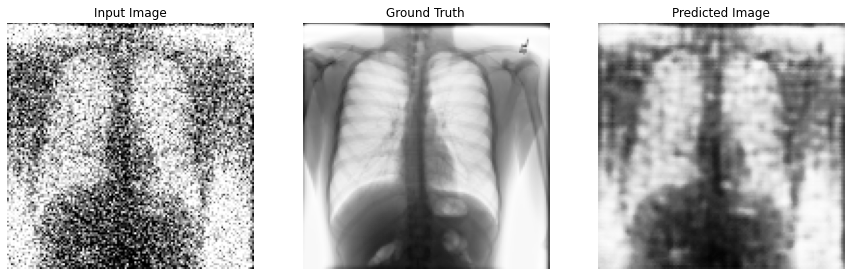

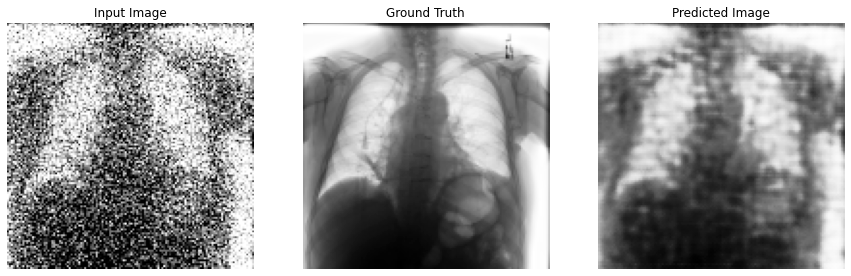

Epoch:  13
........
Time taken for epoch 14 is 14.133347511291504 sec



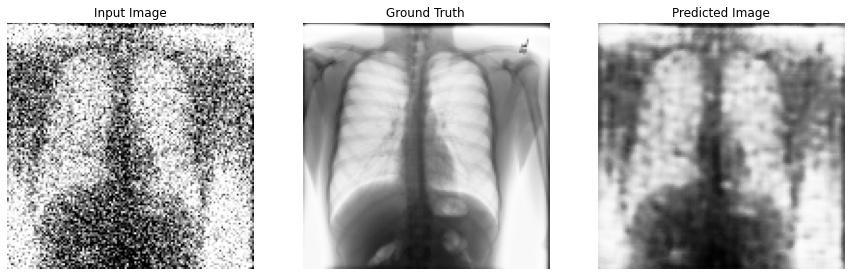

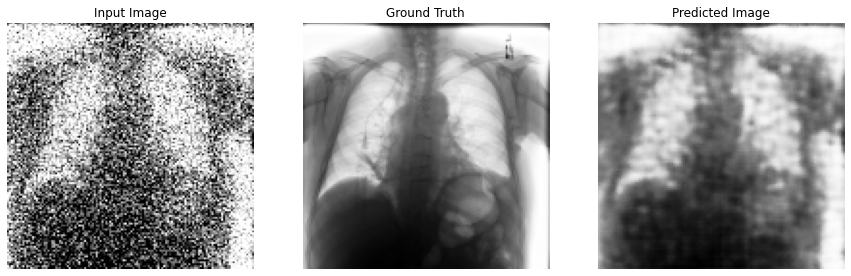

Epoch:  14
........
Time taken for epoch 15 is 13.996958255767822 sec



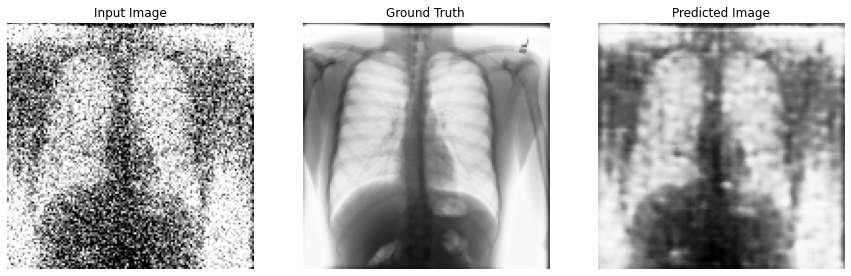

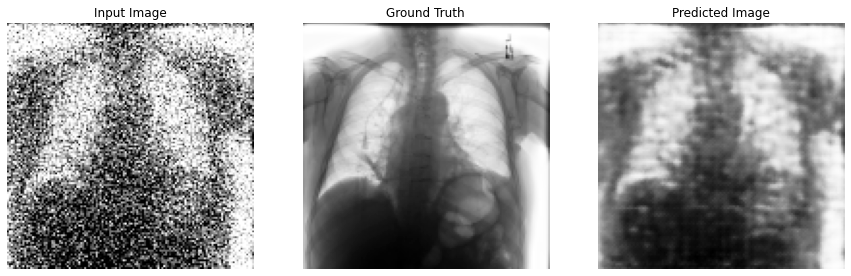

Epoch:  15
........
Time taken for epoch 16 is 13.821434736251831 sec



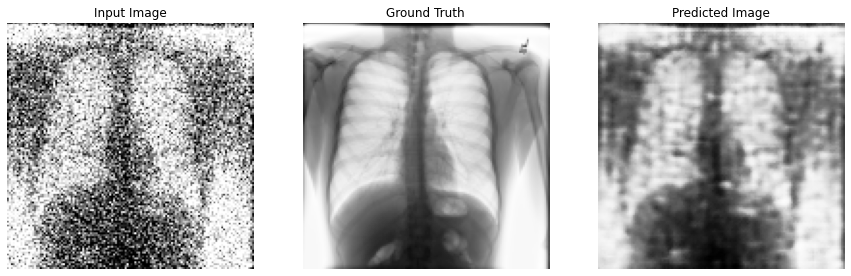

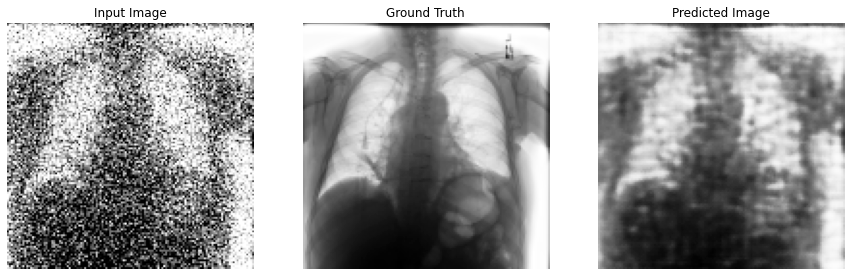

Epoch:  16
........
Time taken for epoch 17 is 14.924541234970093 sec



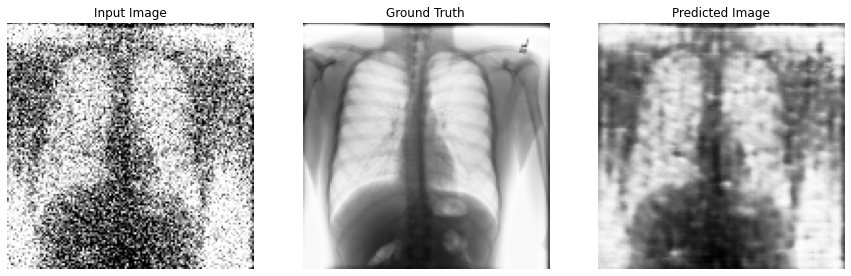

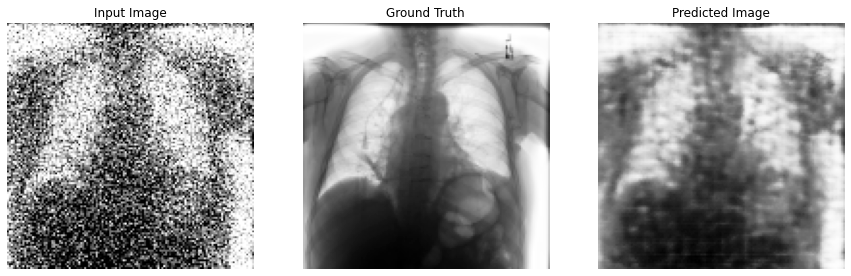

Epoch:  17
........
Time taken for epoch 18 is 13.796567916870117 sec



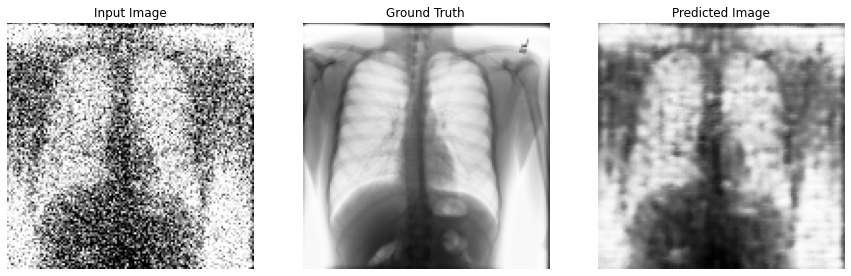

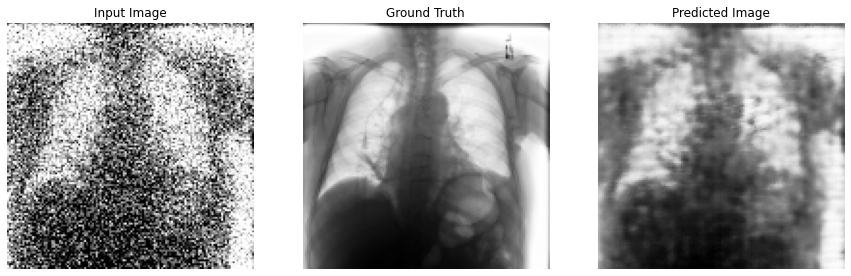

Epoch:  18
........
Time taken for epoch 19 is 14.07698369026184 sec



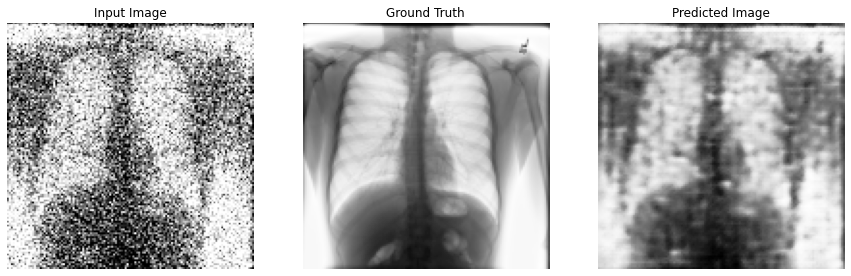

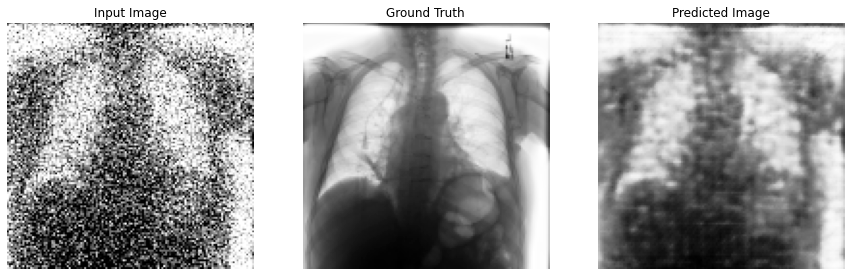

Epoch:  19
........
Time taken for epoch 20 is 14.4804527759552 sec



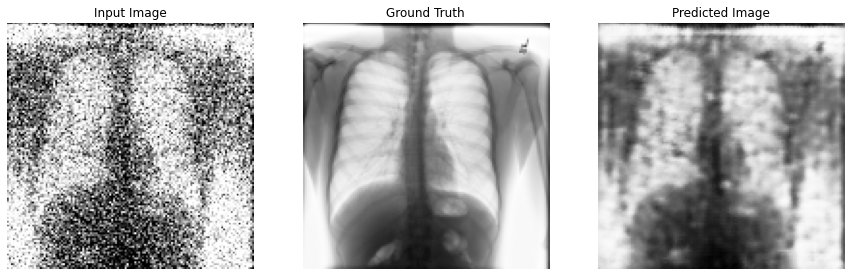

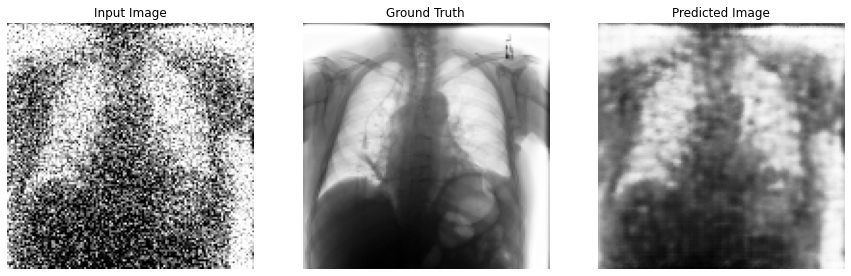

Epoch:  20
........
Time taken for epoch 21 is 14.022684335708618 sec



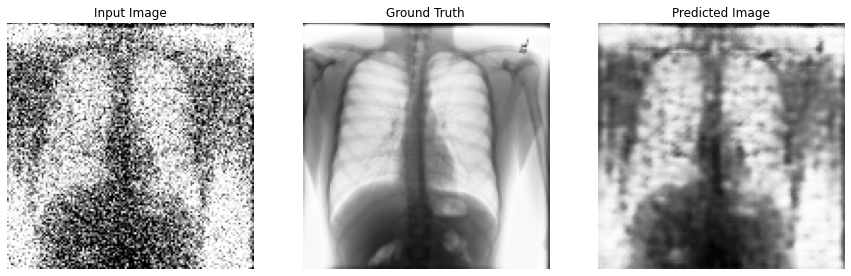

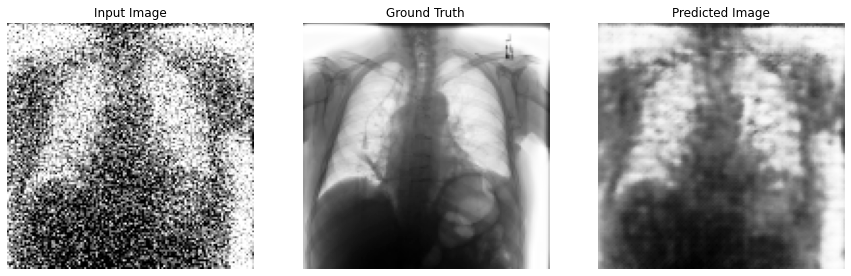

Epoch:  21
........
Time taken for epoch 22 is 14.9592924118042 sec



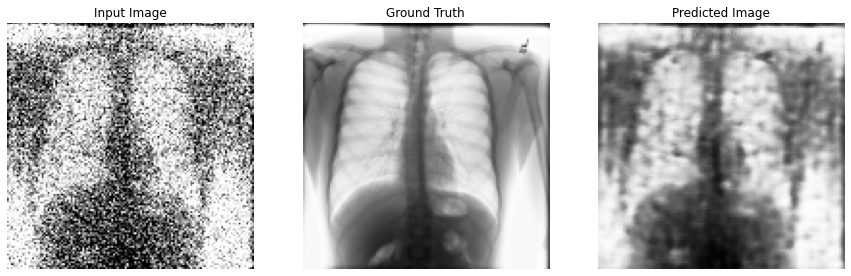

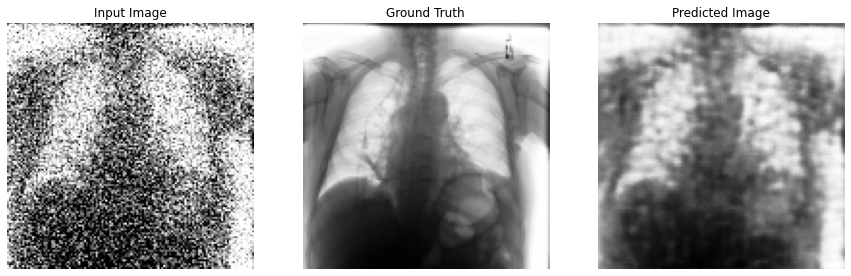

Epoch:  22
........
Time taken for epoch 23 is 14.204780340194702 sec



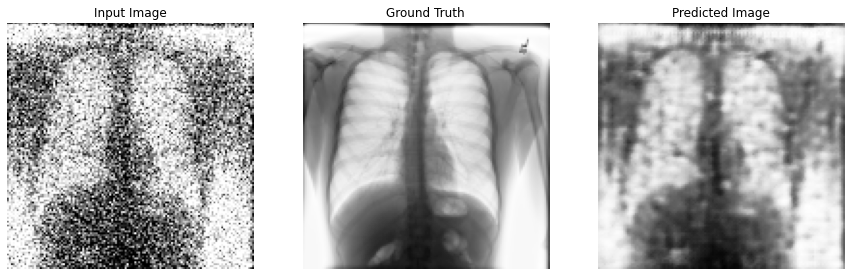

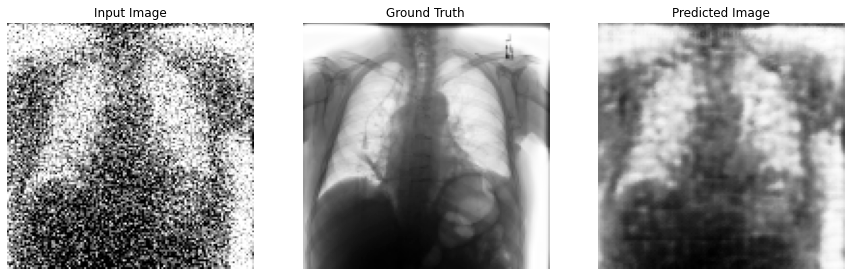

Epoch:  23
........
Time taken for epoch 24 is 13.657841920852661 sec



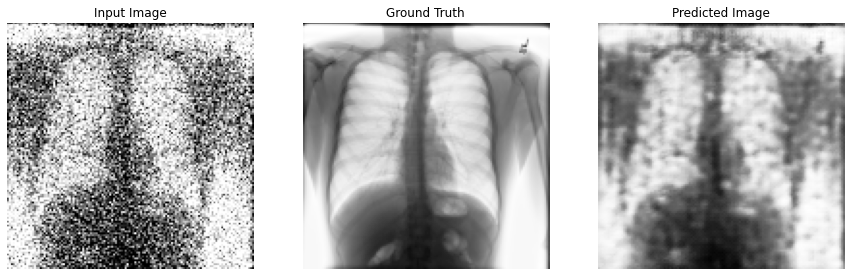

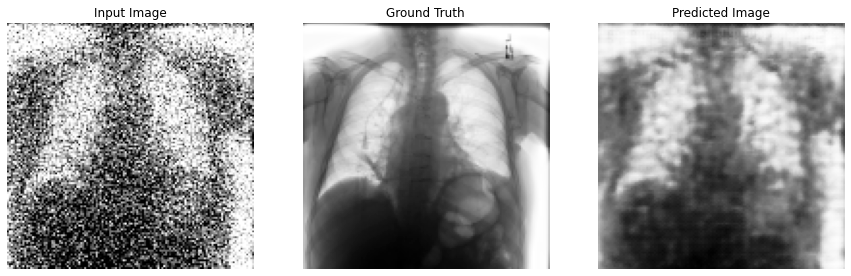

Epoch:  24
........
Time taken for epoch 25 is 14.613539934158325 sec



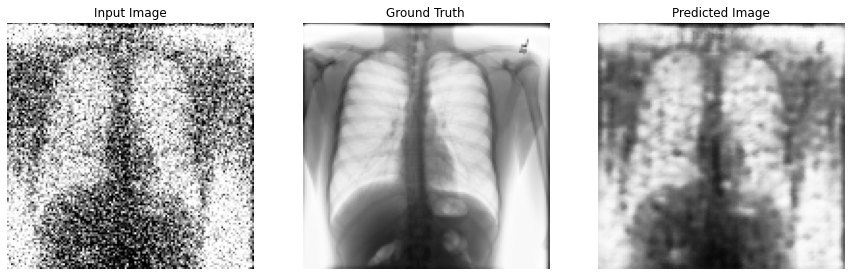

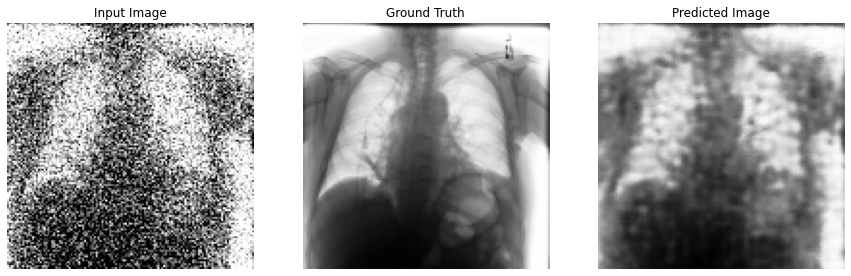

Epoch:  25
........
Time taken for epoch 26 is 13.670875310897827 sec



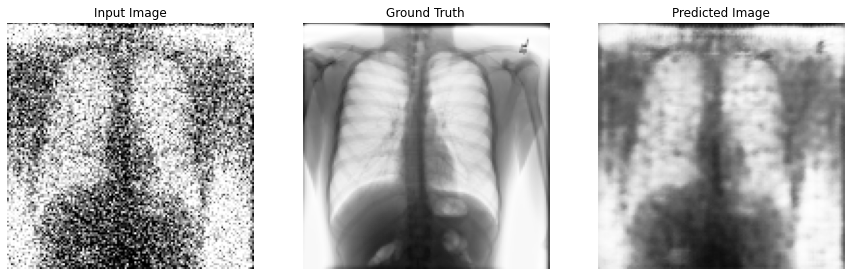

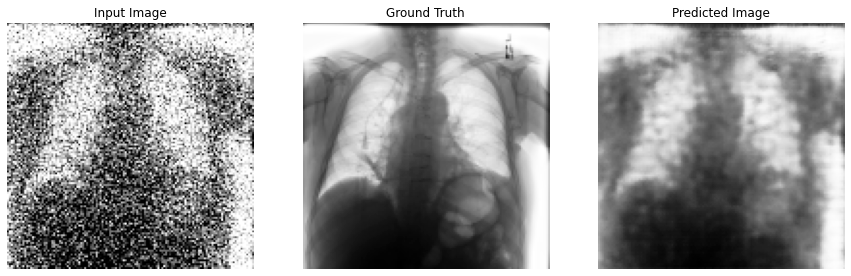

Epoch:  26
........
Time taken for epoch 27 is 13.74573040008545 sec



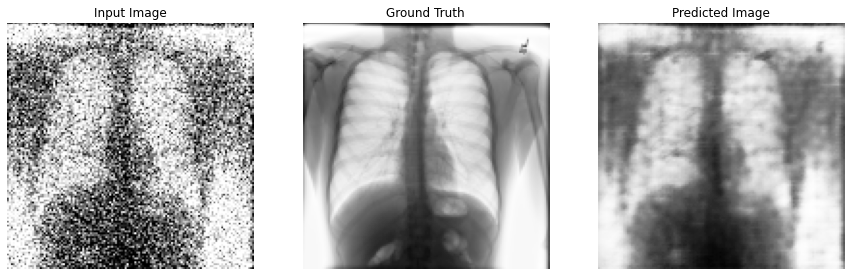

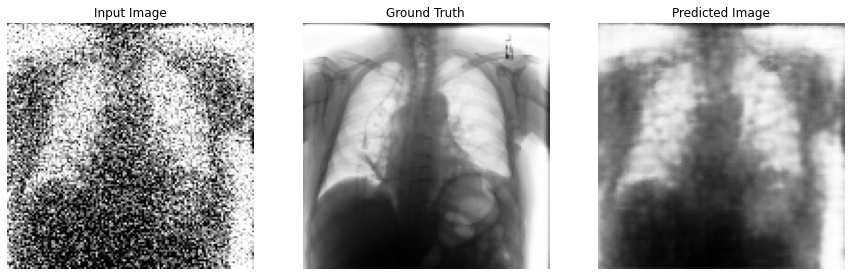

Epoch:  27
........
Time taken for epoch 28 is 13.789400100708008 sec



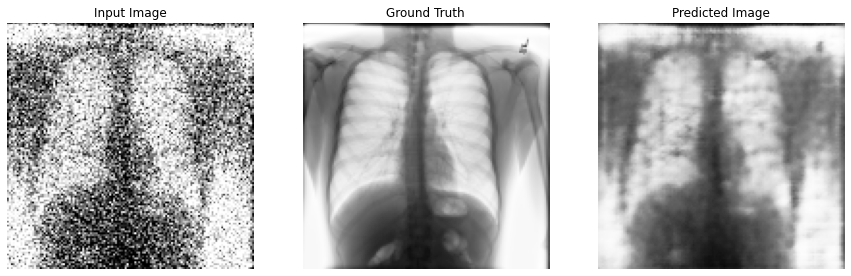

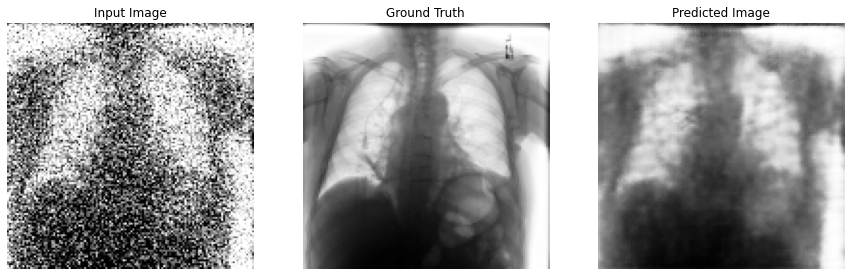

Epoch:  28
........
Time taken for epoch 29 is 13.665542364120483 sec



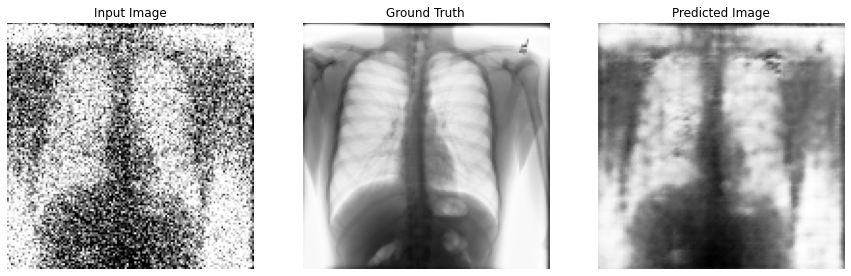

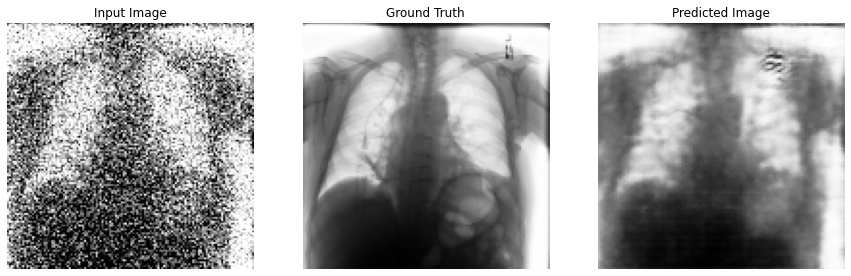

Epoch:  29
........
Time taken for epoch 30 is 14.316698789596558 sec



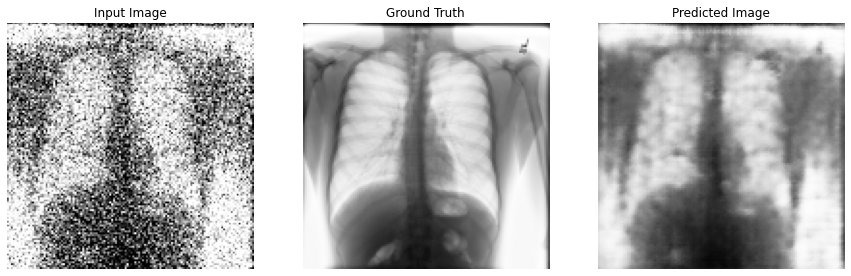

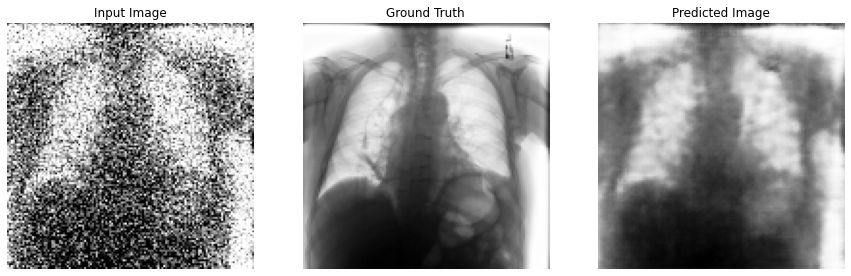

Epoch:  30
........
Time taken for epoch 31 is 14.024068593978882 sec



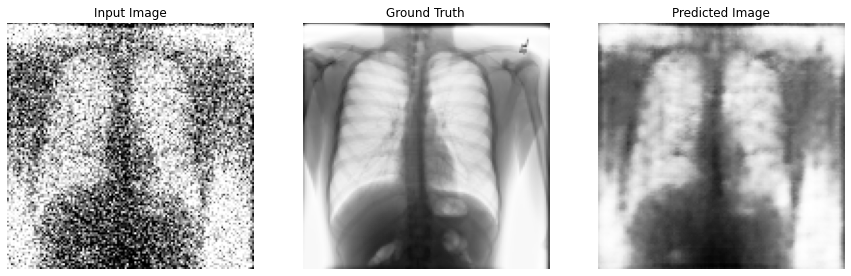

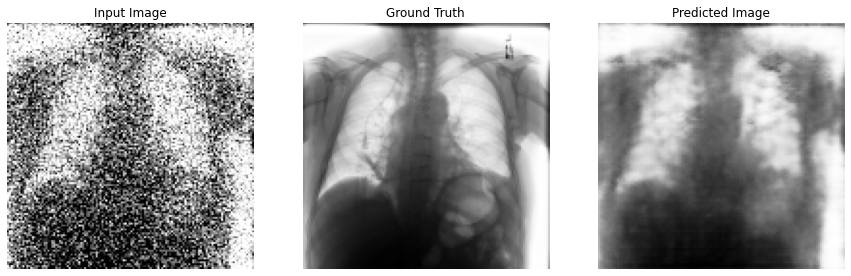

Epoch:  31
........
Time taken for epoch 32 is 13.881334781646729 sec



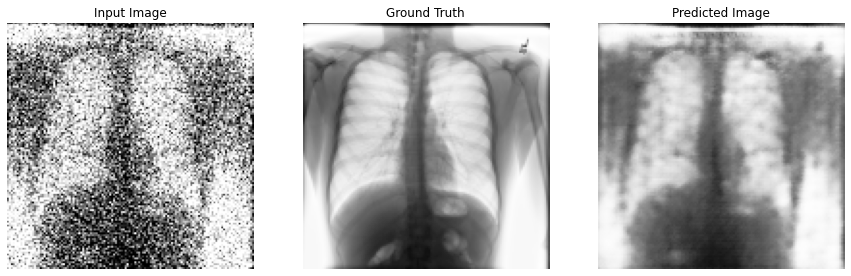

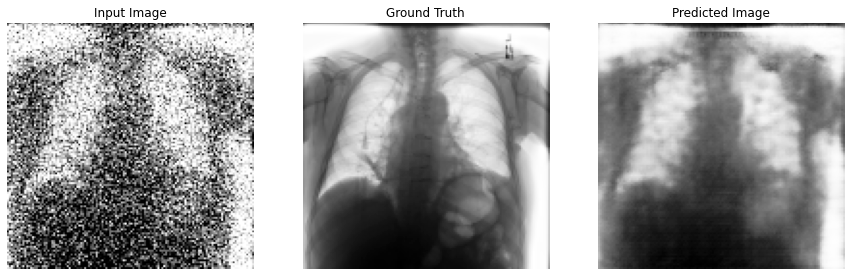

Epoch:  32
........
Time taken for epoch 33 is 13.805747270584106 sec



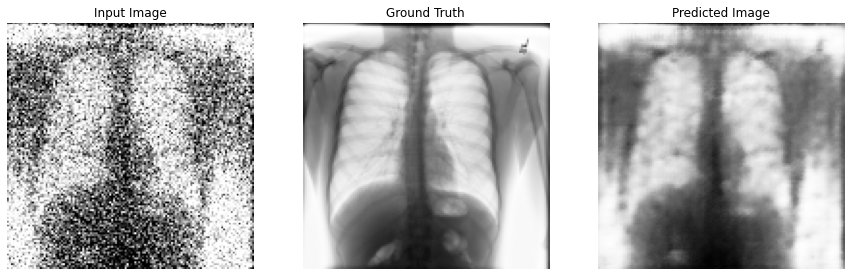

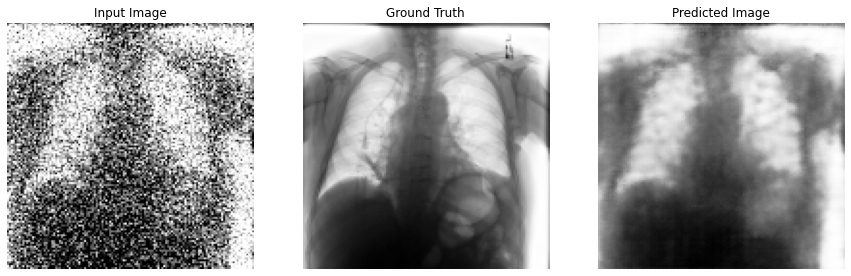

Epoch:  33
........
Time taken for epoch 34 is 13.88502836227417 sec



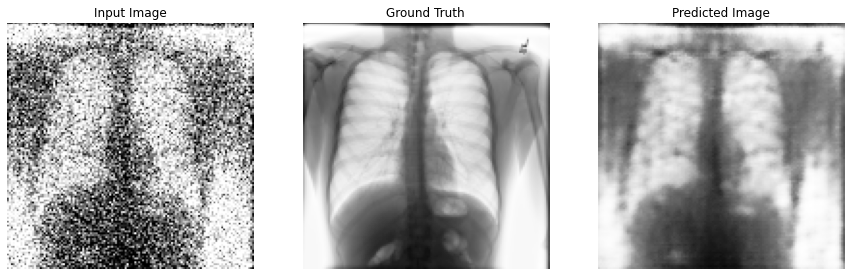

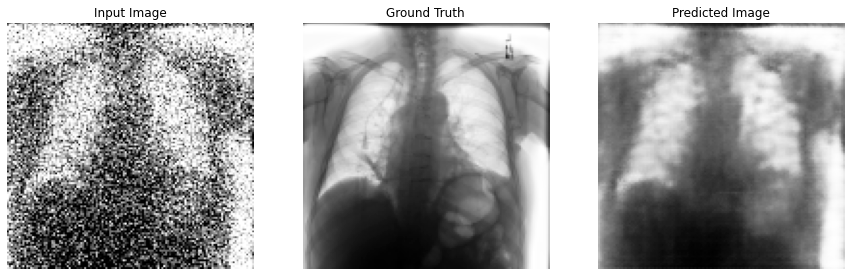

Epoch:  34
........
Time taken for epoch 35 is 14.852324724197388 sec



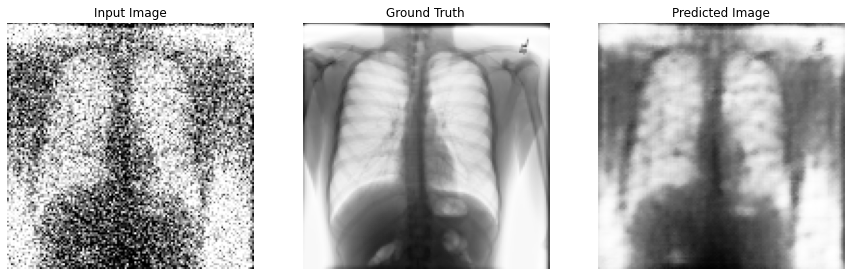

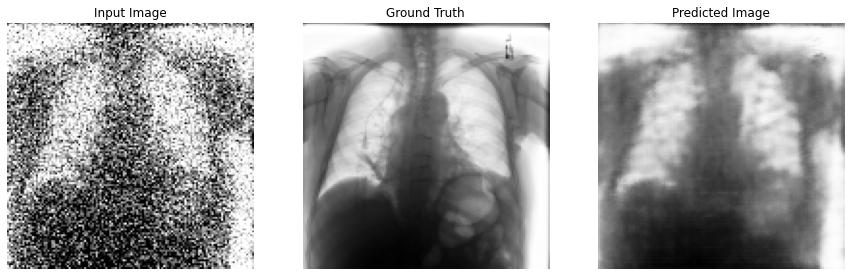

Epoch:  35
........
Time taken for epoch 36 is 13.652313232421875 sec



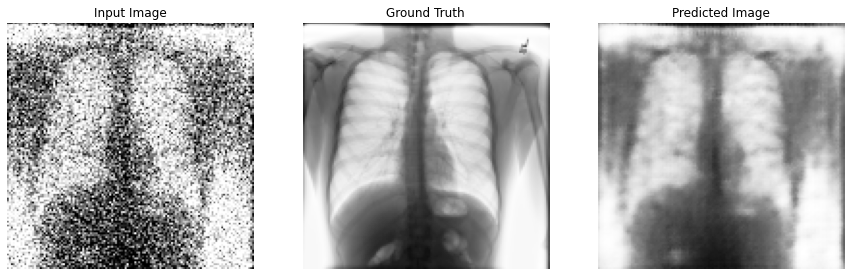

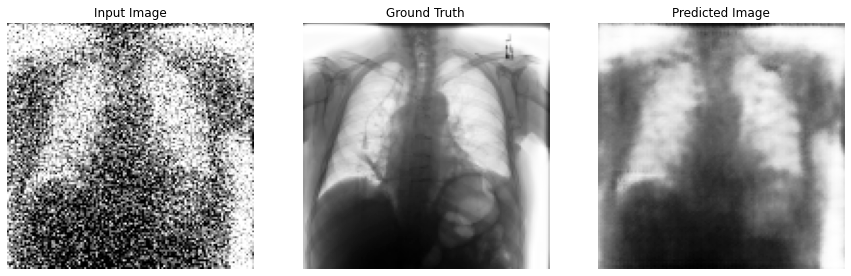

Epoch:  36
........
Time taken for epoch 37 is 13.606276035308838 sec



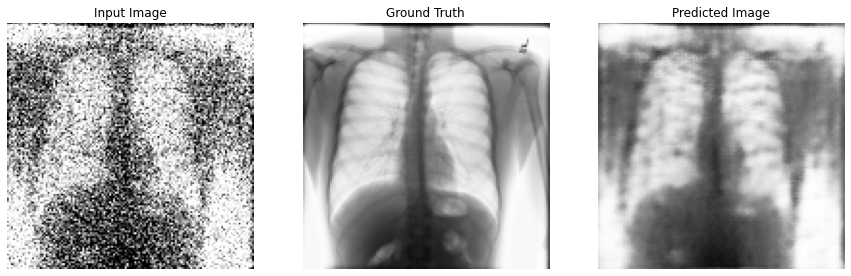

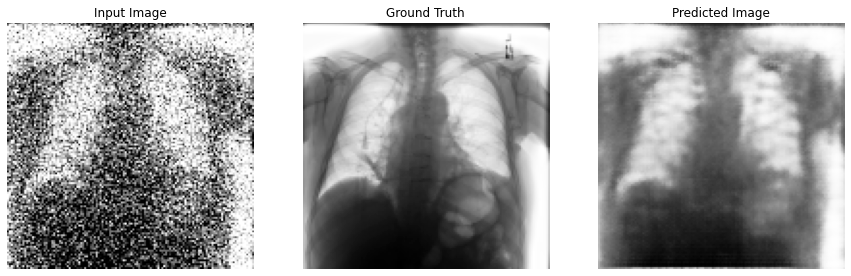

Epoch:  37
........
Time taken for epoch 38 is 13.721007108688354 sec



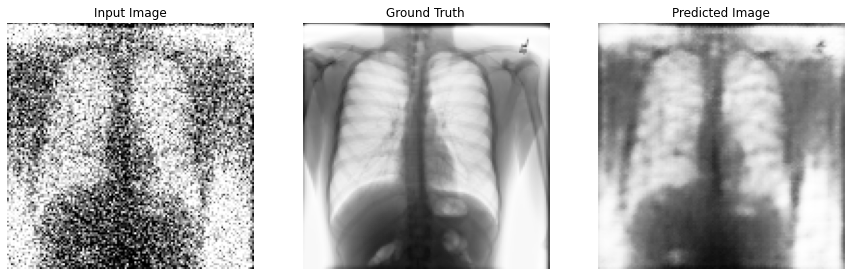

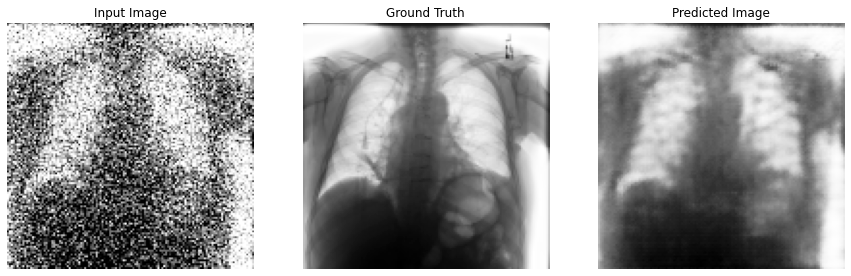

Epoch:  38
........
Time taken for epoch 39 is 13.88756251335144 sec



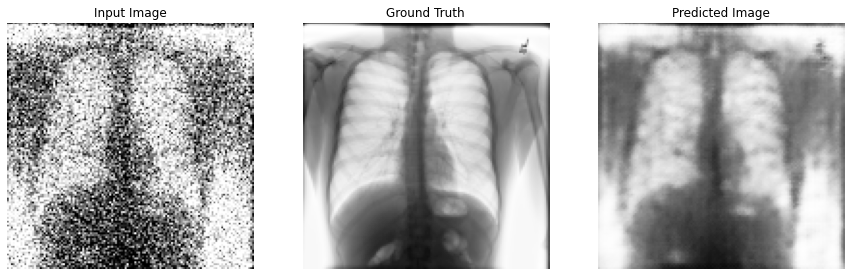

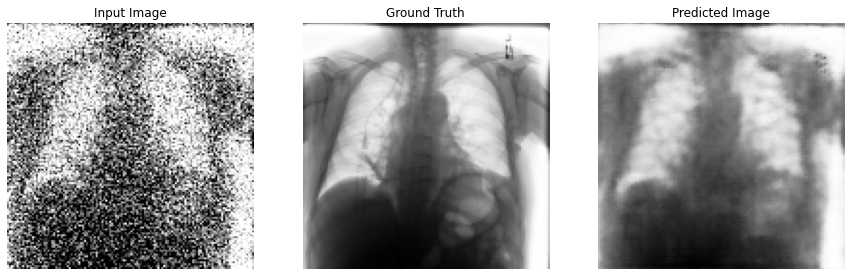

Epoch:  39
........
Time taken for epoch 40 is 14.279476404190063 sec



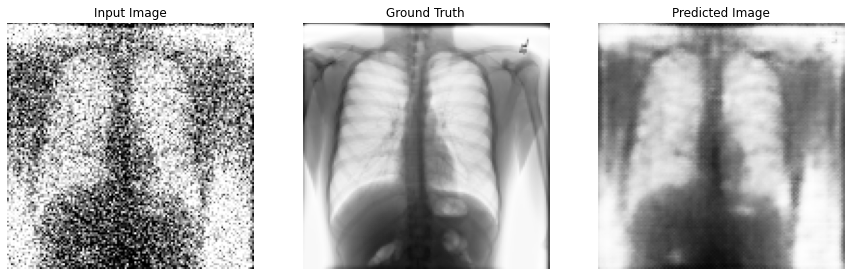

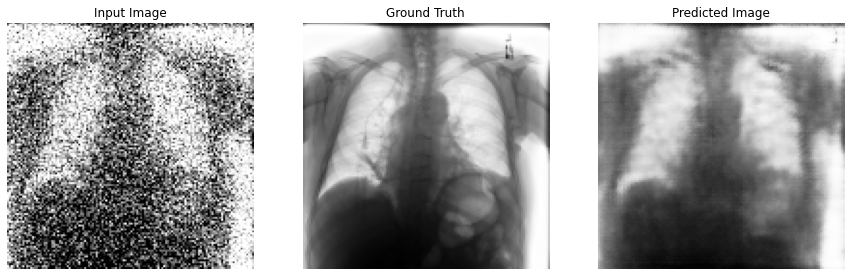

Epoch:  40
........
Time taken for epoch 41 is 13.708985567092896 sec



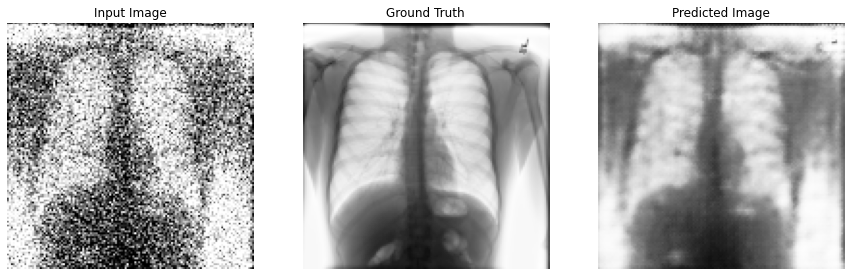

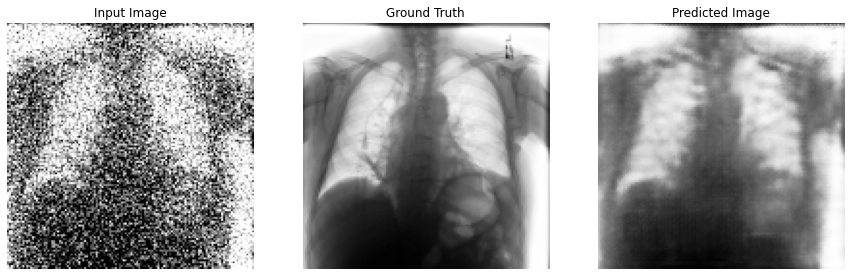

Epoch:  41
........
Time taken for epoch 42 is 13.675651788711548 sec



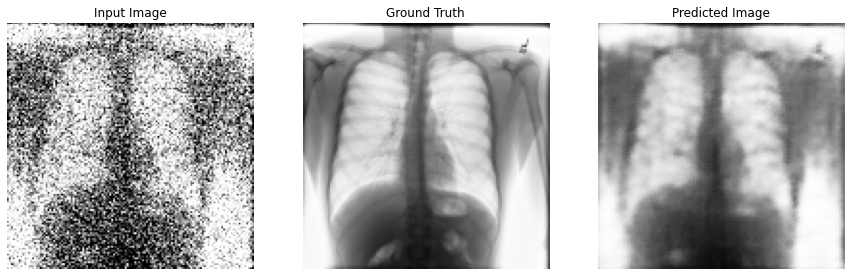

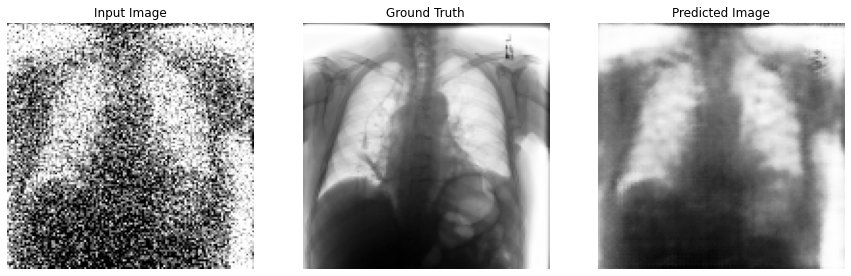

Epoch:  42
........
Time taken for epoch 43 is 13.619835615158081 sec



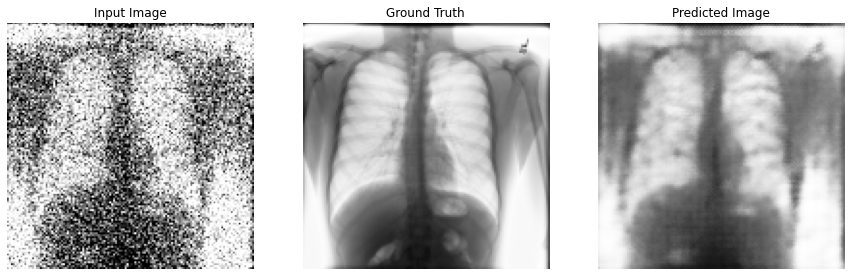

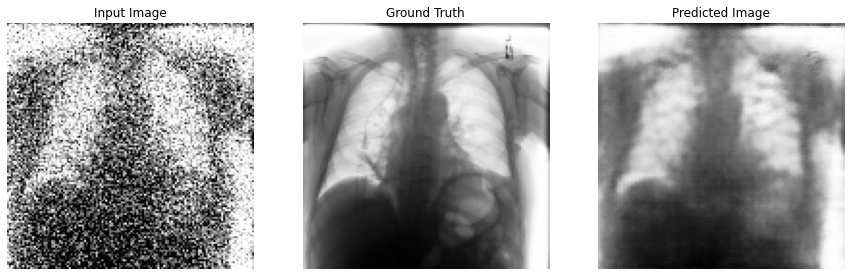

Epoch:  43
........
Time taken for epoch 44 is 13.763695478439331 sec



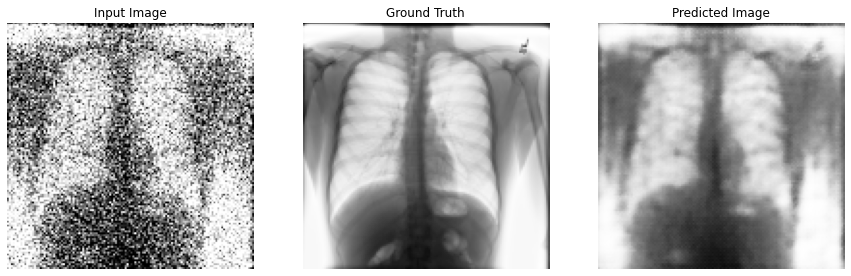

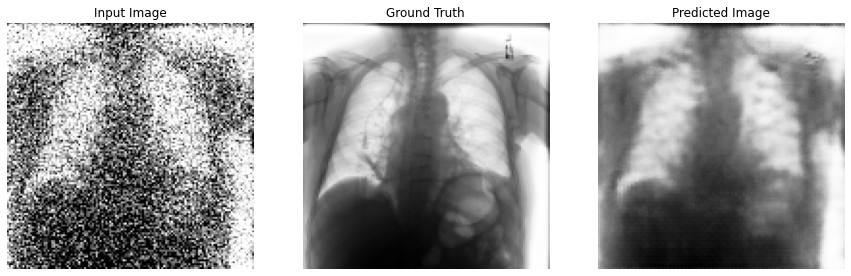

Epoch:  44
........
Time taken for epoch 45 is 13.587257385253906 sec



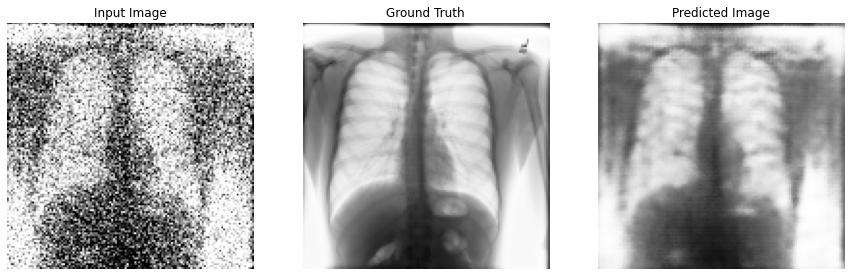

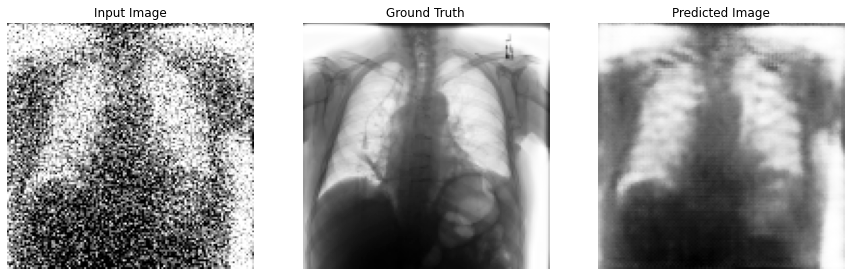

Epoch:  45
........
Time taken for epoch 46 is 17.884368181228638 sec



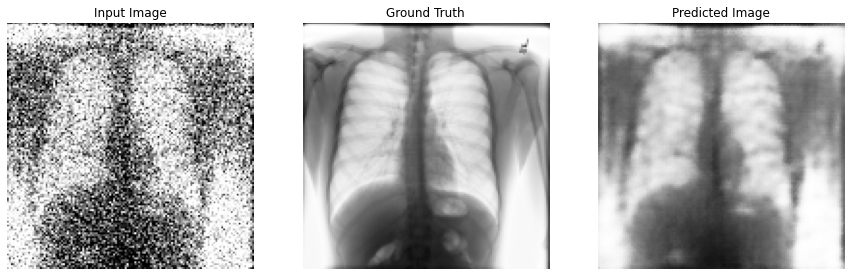

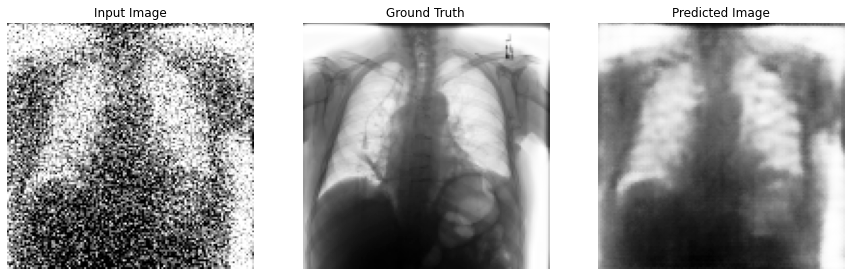

Epoch:  46
........
Time taken for epoch 47 is 13.567765951156616 sec



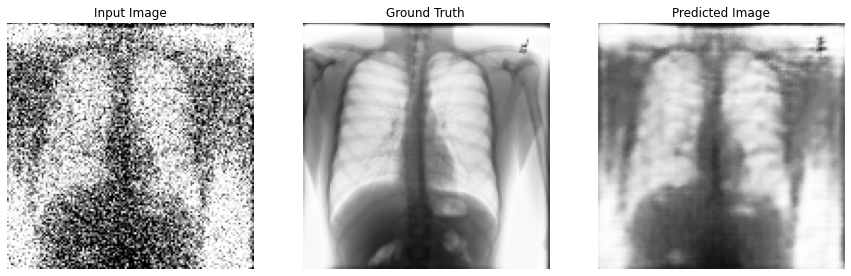

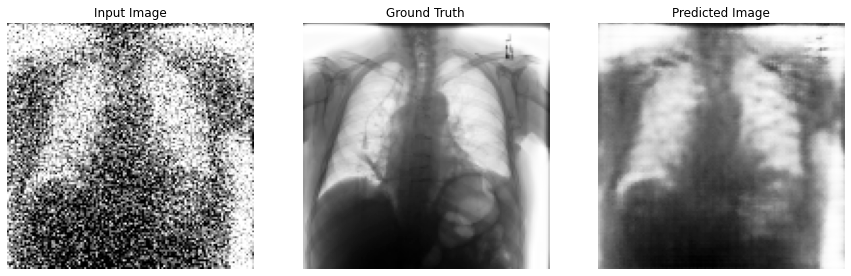

Epoch:  47
........
Time taken for epoch 48 is 13.60553240776062 sec



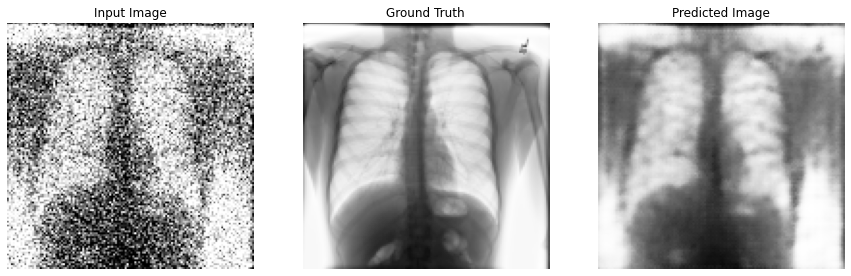

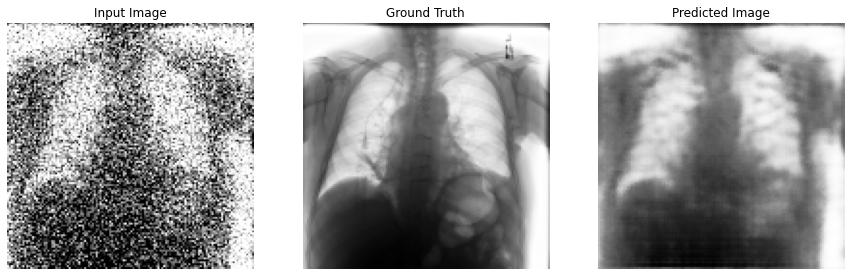

Epoch:  48
........
Time taken for epoch 49 is 13.820592403411865 sec



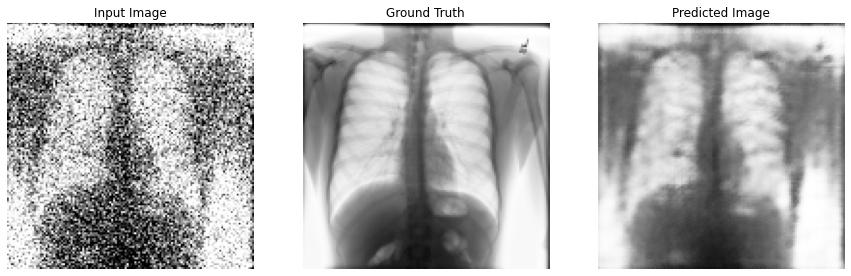

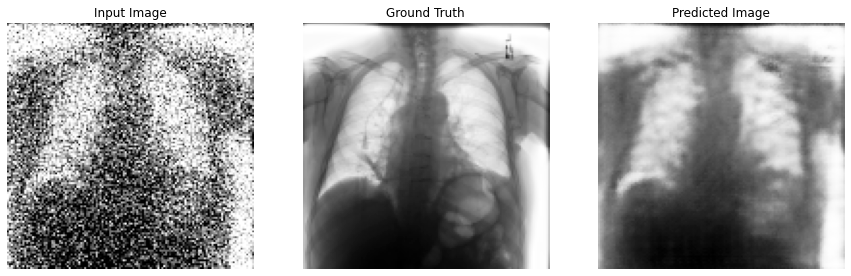

Epoch:  49
........
Time taken for epoch 50 is 14.395017147064209 sec



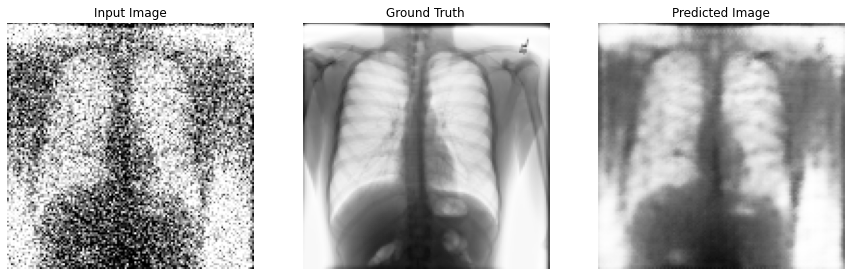

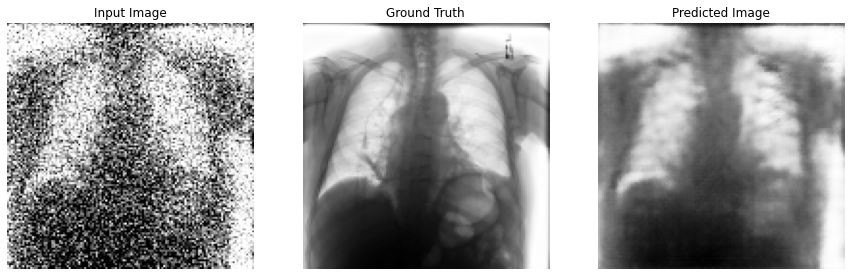

Epoch:  50
........
Time taken for epoch 51 is 13.862189769744873 sec



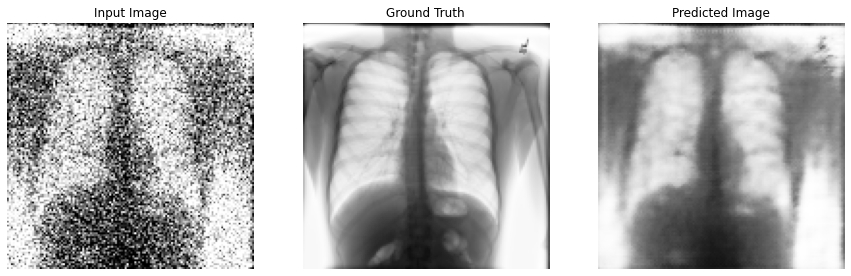

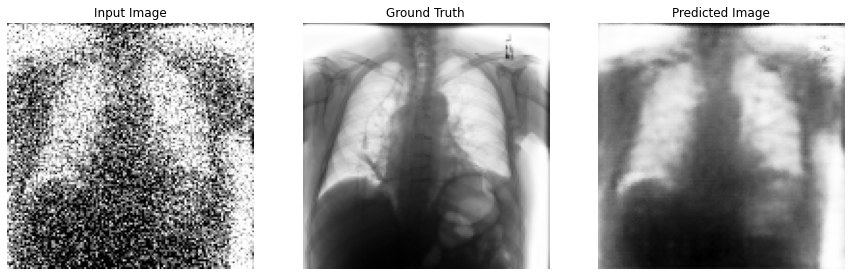

Epoch:  51
........
Time taken for epoch 52 is 13.790946006774902 sec



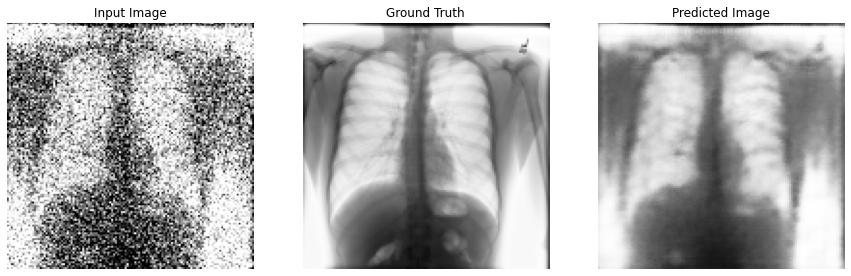

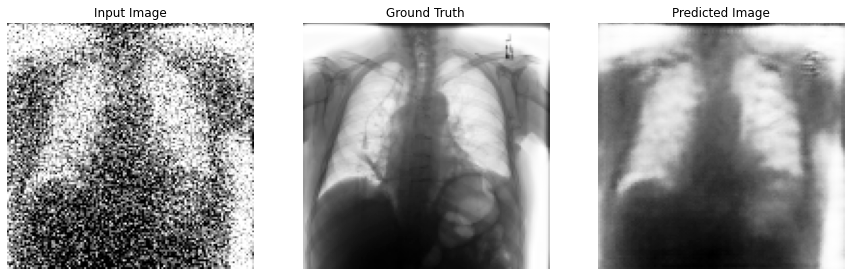

Epoch:  52
........
Time taken for epoch 53 is 13.867767333984375 sec



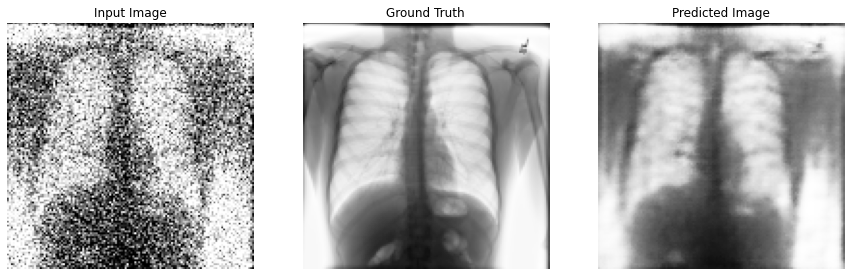

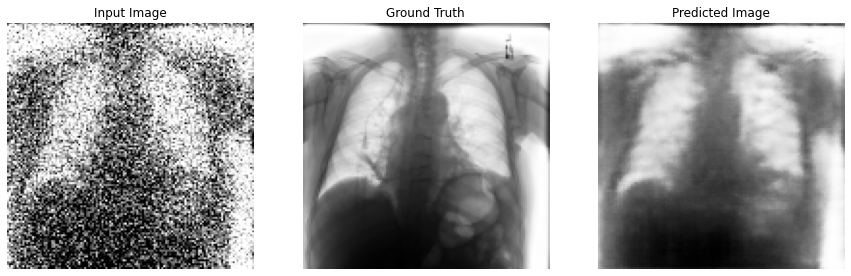

Epoch:  53
........
Time taken for epoch 54 is 13.781324625015259 sec



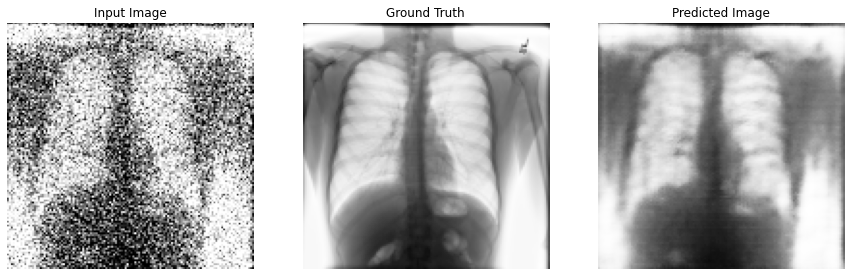

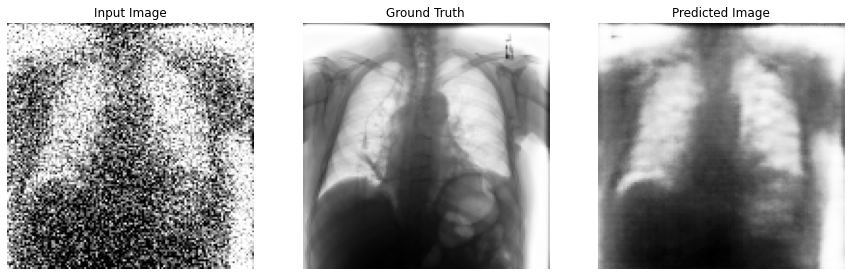

Epoch:  54
........
Time taken for epoch 55 is 13.680431604385376 sec



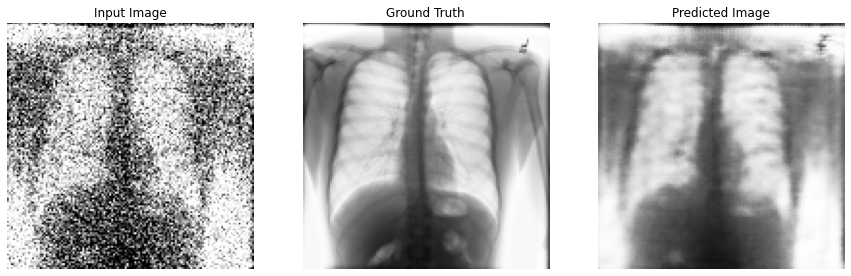

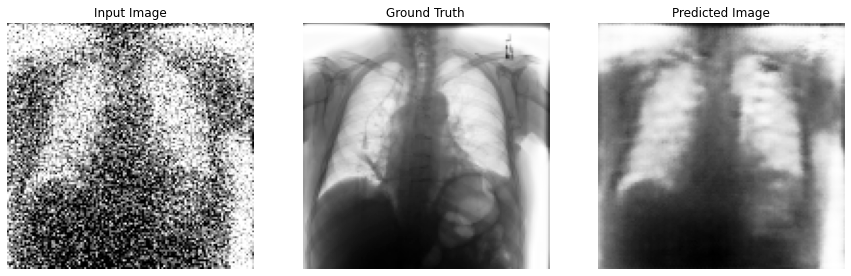

Epoch:  55
........
Time taken for epoch 56 is 13.582167148590088 sec



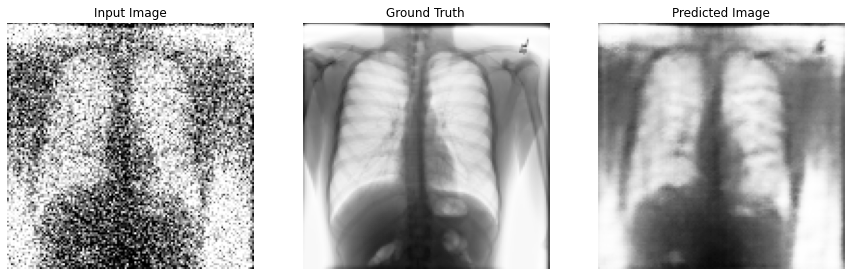

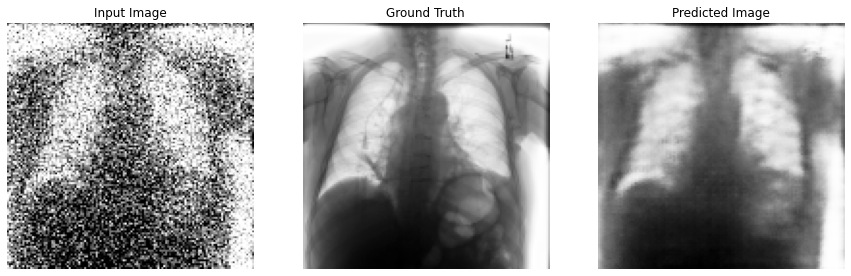

Epoch:  56
........
Time taken for epoch 57 is 13.700214385986328 sec



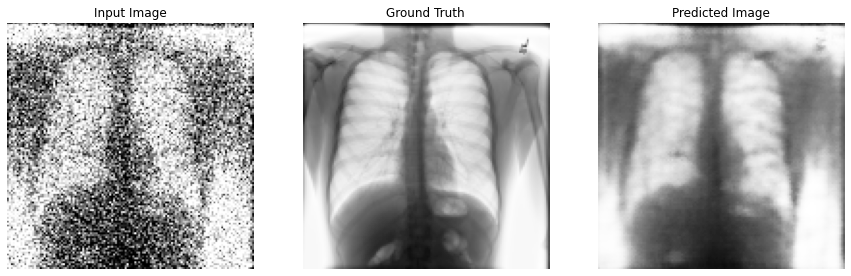

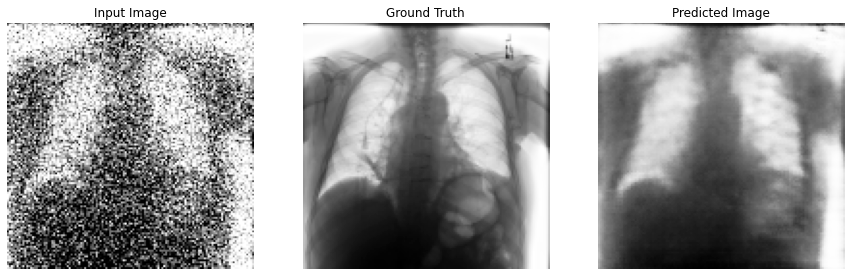

Epoch:  57
........
Time taken for epoch 58 is 15.137828588485718 sec



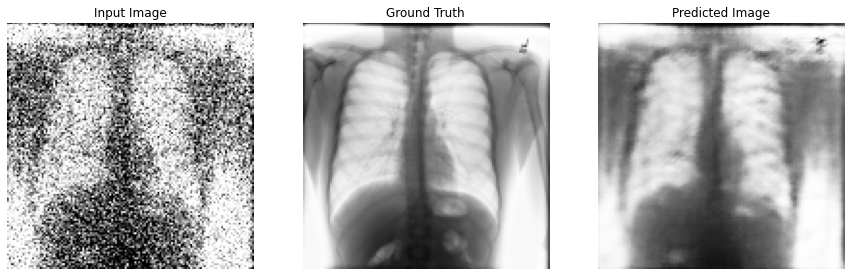

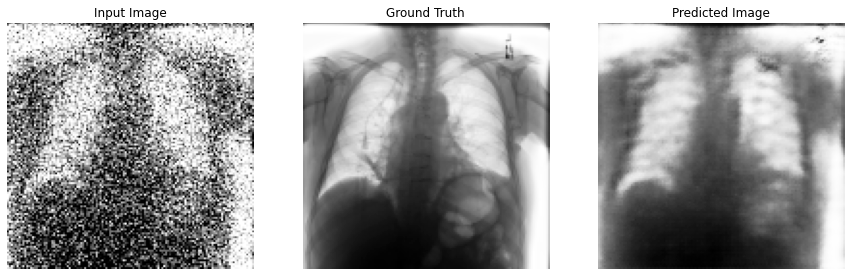

Epoch:  58
........
Time taken for epoch 59 is 13.809175491333008 sec



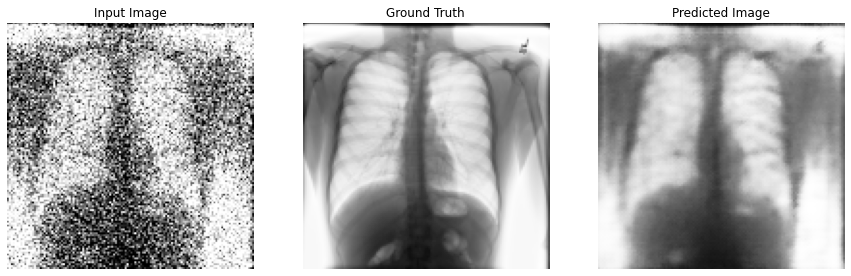

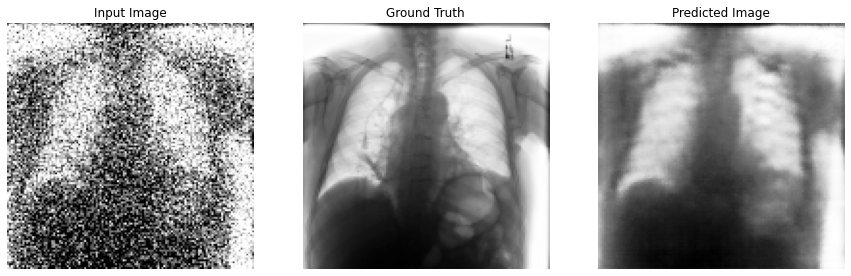

Epoch:  59
........
Time taken for epoch 60 is 14.286296844482422 sec



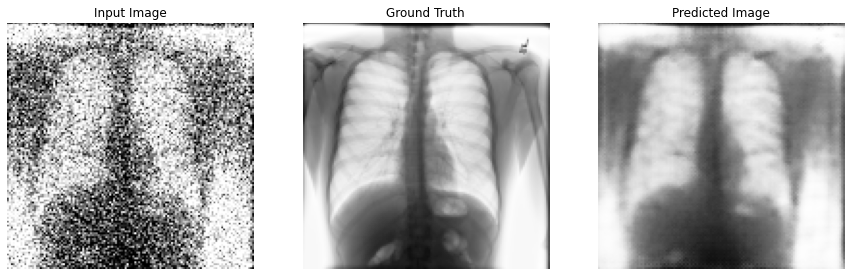

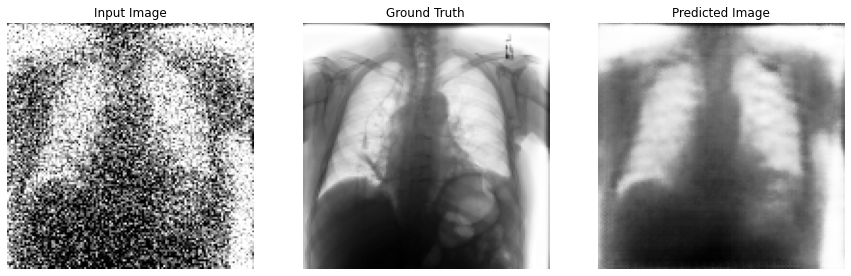

Epoch:  60
........
Time taken for epoch 61 is 13.58419942855835 sec



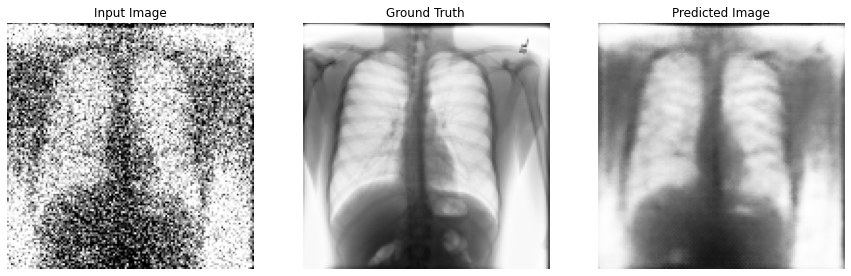

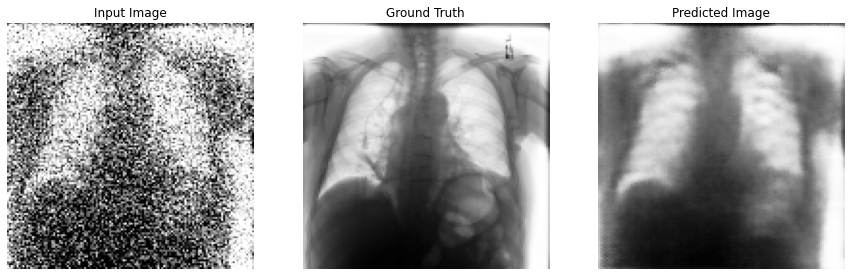

Epoch:  61
........
Time taken for epoch 62 is 13.604349851608276 sec



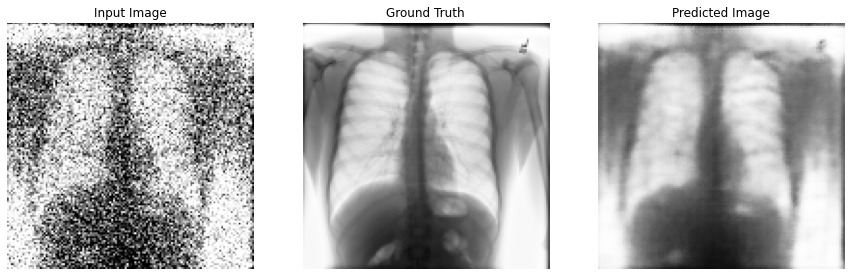

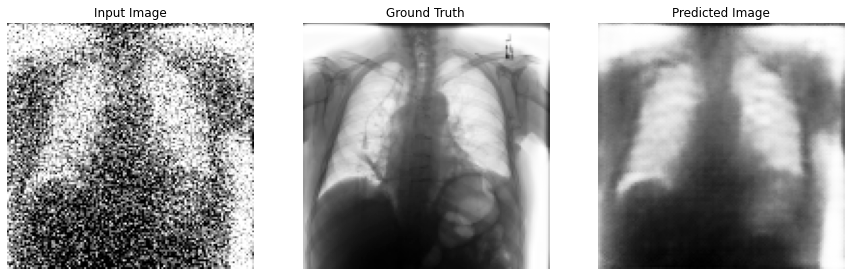

Epoch:  62
........
Time taken for epoch 63 is 13.502123355865479 sec



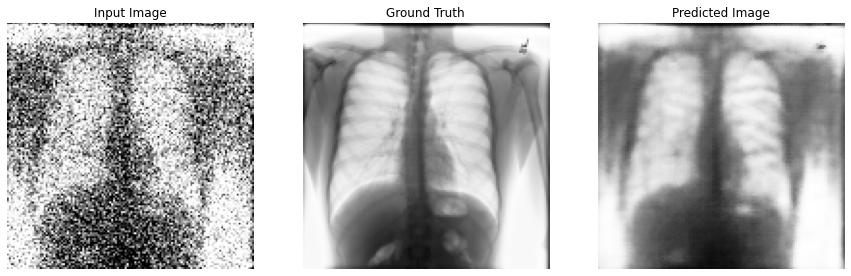

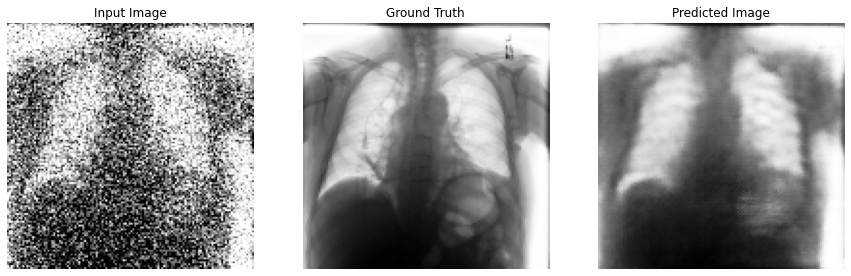

Epoch:  63
........
Time taken for epoch 64 is 13.65364956855774 sec



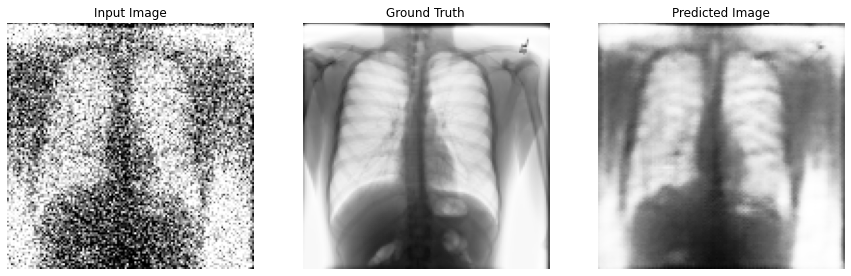

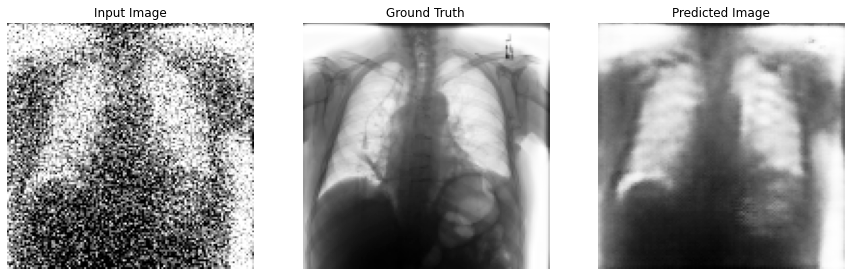

Epoch:  64
........
Time taken for epoch 65 is 13.743350267410278 sec



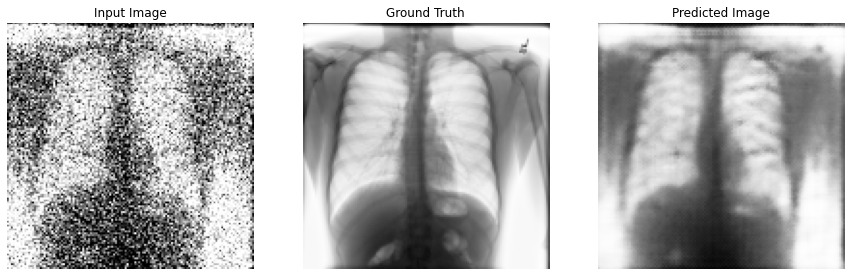

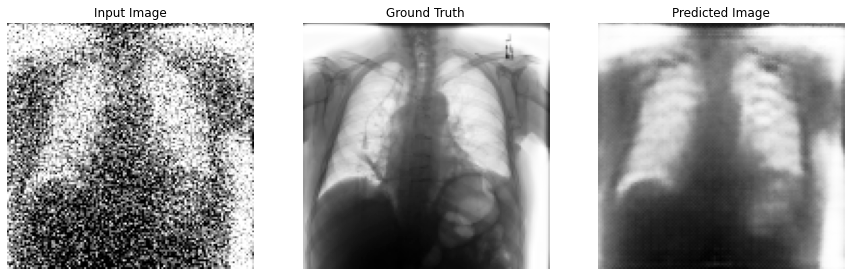

Epoch:  65
........
Time taken for epoch 66 is 13.741516351699829 sec



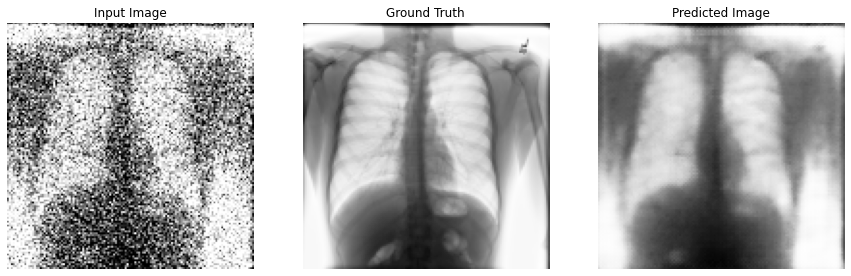

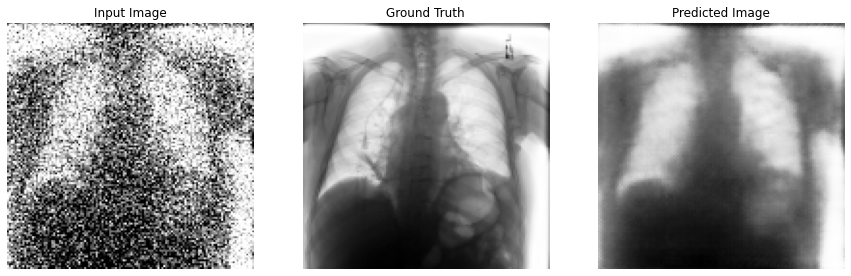

Epoch:  66
........
Time taken for epoch 67 is 13.74093770980835 sec



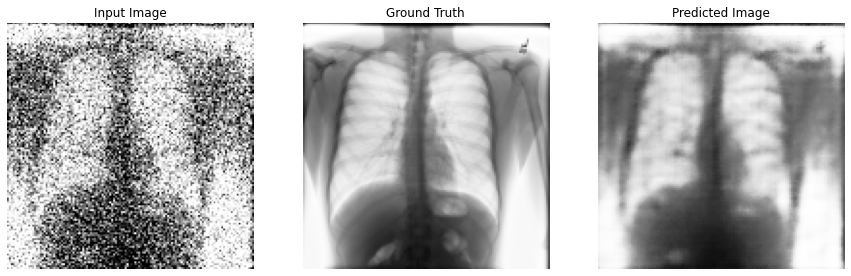

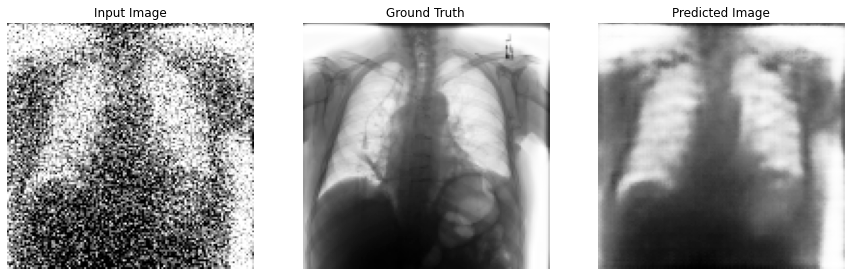

Epoch:  67
........
Time taken for epoch 68 is 13.632956266403198 sec



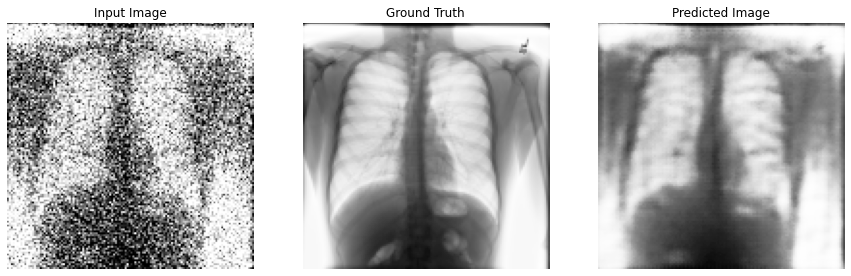

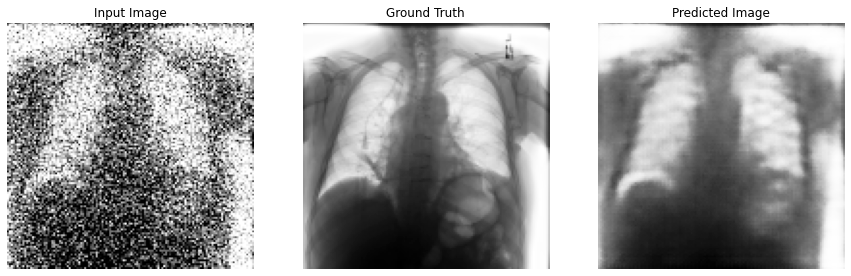

Epoch:  68
........
Time taken for epoch 69 is 13.6855788230896 sec



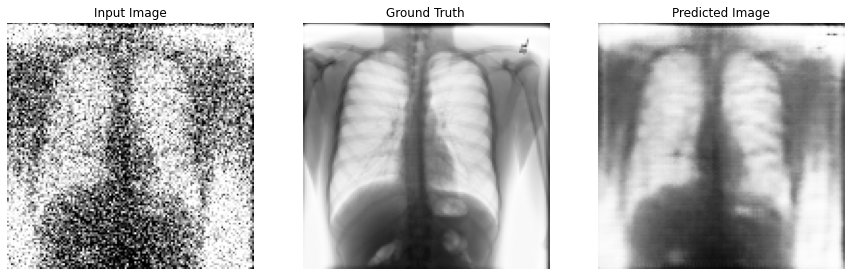

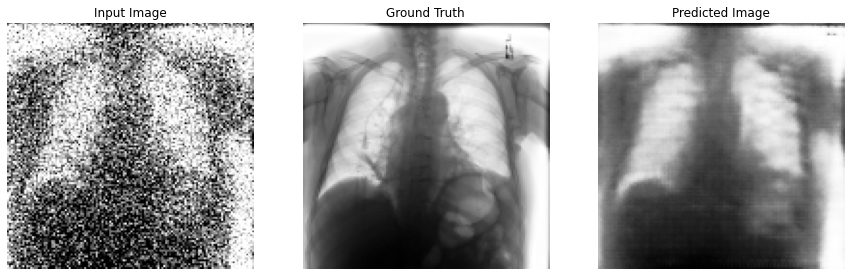

Epoch:  69
........
Time taken for epoch 70 is 14.178153991699219 sec



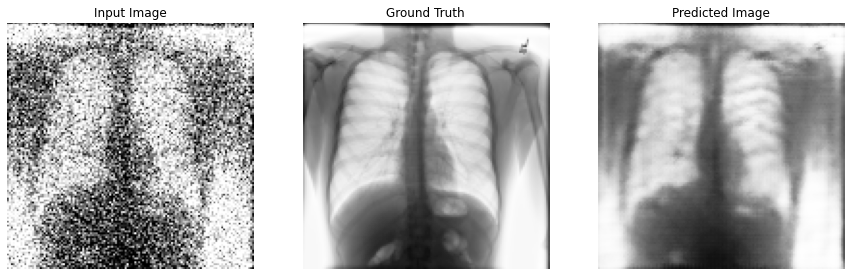

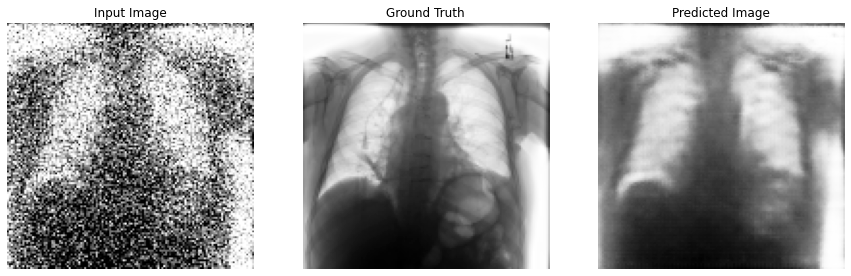

Epoch:  70
........
Time taken for epoch 71 is 13.695335626602173 sec



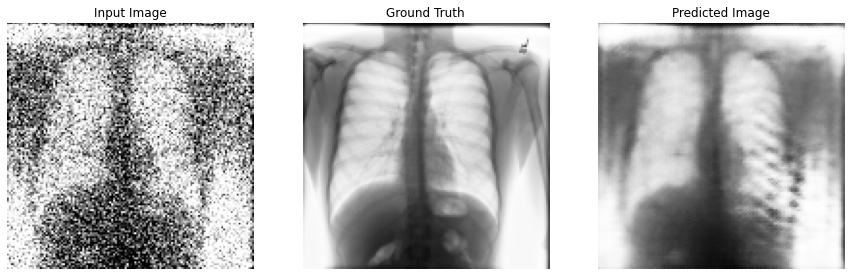

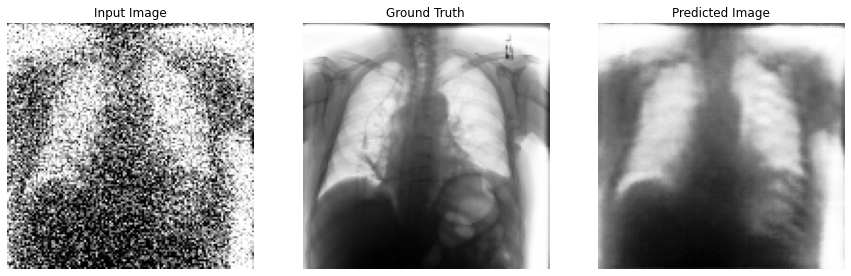

Epoch:  71
........
Time taken for epoch 72 is 13.614710807800293 sec



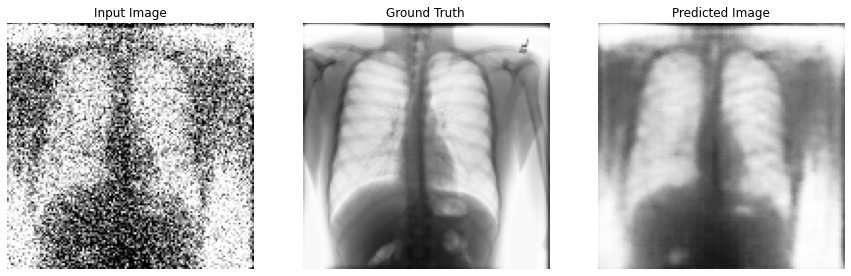

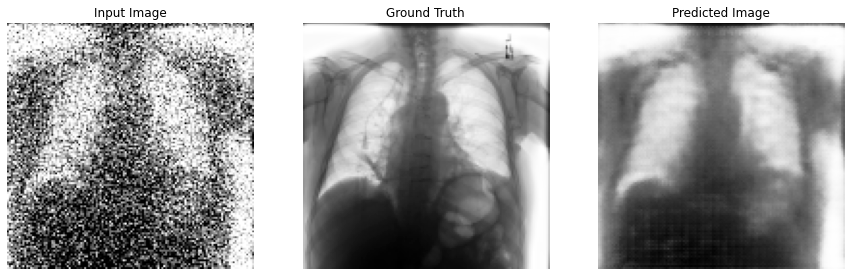

Epoch:  72
........
Time taken for epoch 73 is 15.401941776275635 sec



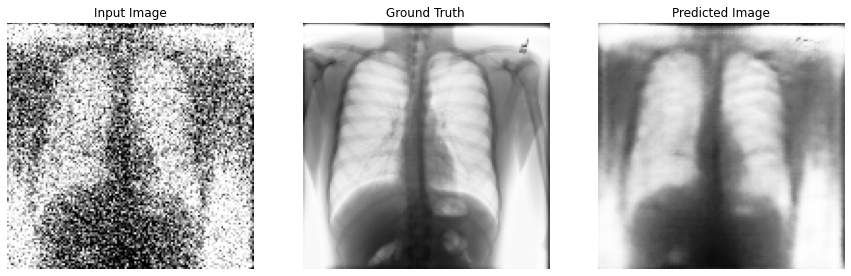

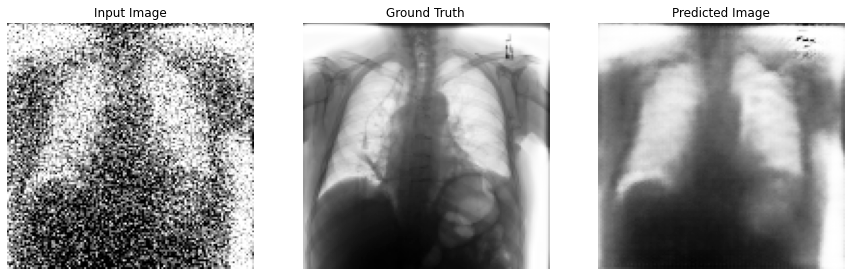

Epoch:  73
........
Time taken for epoch 74 is 13.586177825927734 sec



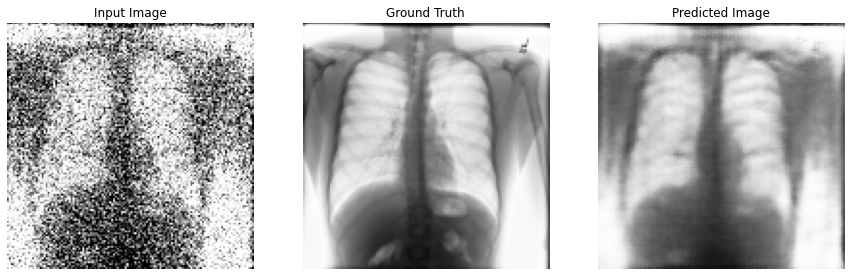

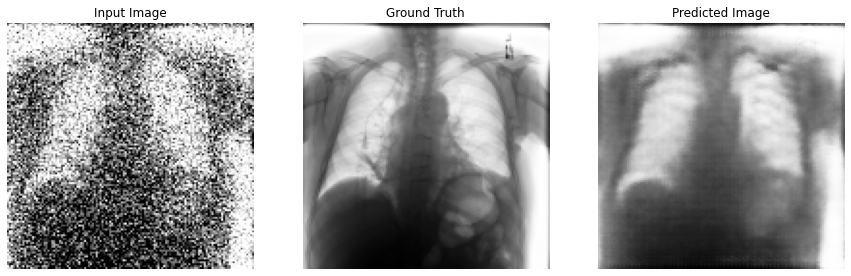

Epoch:  74
.....

In [ ]:
train_set = np.array_split(train_images, 15)
train_noisy_set = np.array_split(train_noisy_images, 15)

# Split training data into chunks.
LAMBDA = 100
for i, (train_imgs, noisy_imgs) in enumerate(zip(train_set, train_noisy_set)):
    # if i == 10:
    #     LAMBDA = 1
    #     print("Changed from LAMBDA=500 to LAMBDA=1")

    train = (
        tf.data.Dataset.from_tensor_slices((train_imgs, noisy_imgs))
        .shuffle(train_imgs.shape[0])
        .batch(BATCH_SIZE)
    )

    fit(train, EPOCHS_PER_SPLIT * (i + 1), test_images, LAMBDA)

In [34]:
%load_ext tensorboard
# %tensorboard --logdir {log_dir}

# Restore the latest checkpoint and test

In [36]:
# restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

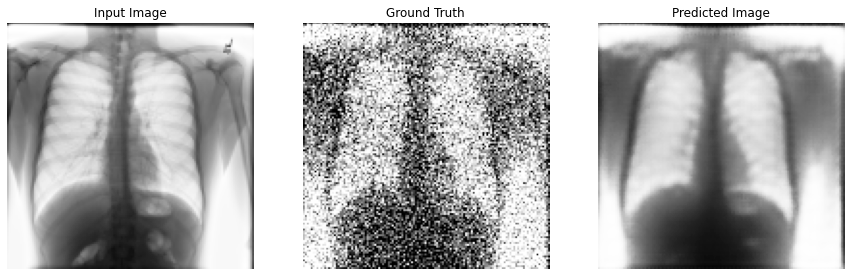

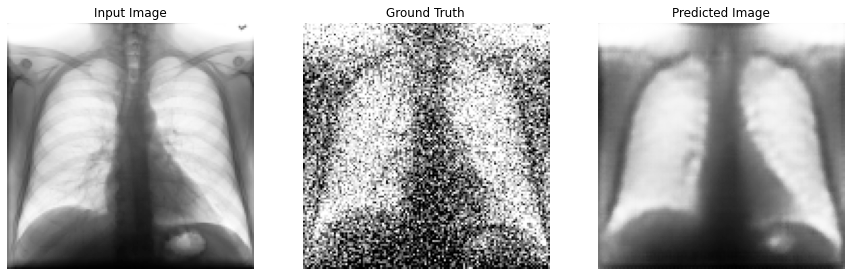

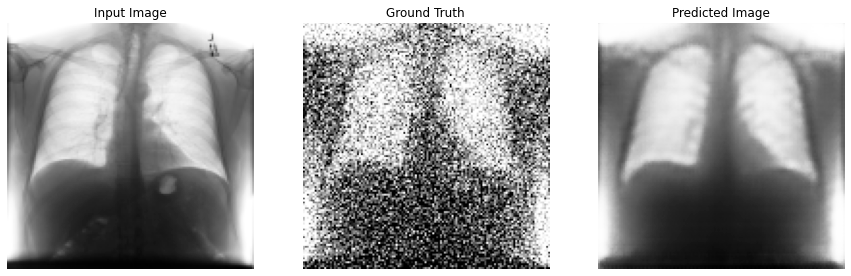

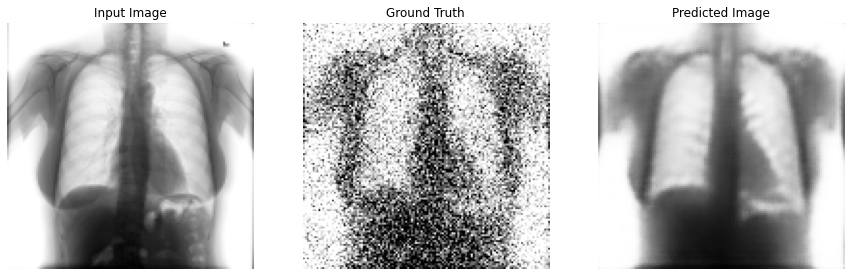

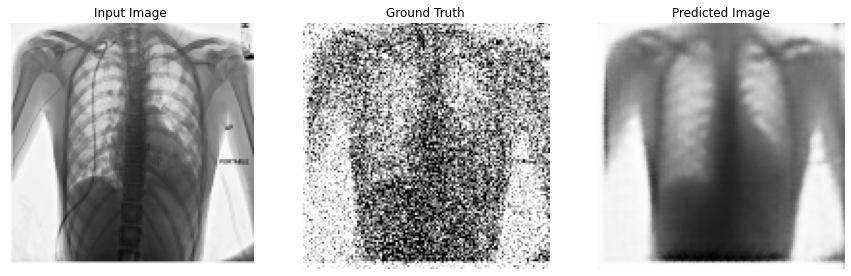

In [37]:
# Run the trained model on a few examples from the test dataset
for inp, tar in test_images.take(5):
    generate_images(generator, inp, tar)